In [1]:
import warnings
warnings.filterwarnings('ignore')

In [1]:
import scanpy as sc
import pandas as pd
import numpy as np

import gseapy

import matplotlib.pyplot as plt
from matplotlib.colors import LinearSegmentedColormap
import seaborn as sns
# from upsetplot import from_contents, UpSet

from scipy.spatial.distance import pdist, squareform
from scipy.stats import chisquare, norm
import scipy.sparse as sp

from statsmodels.stats.multitest import multipletests

import scvelo
from sklearn.decomposition import NMF
from sklearn.preprocessing import minmax_scale

import pickle

import math

from scipy.stats import ttest_ind

/miniconda3/lib/python3.10/site-packages/setuptools_scm/_integration/setuptools.py:30: RuntimeWarning: 
ERROR: setuptools==60.2.0 is used in combination with setuptools_scm>=8.x

Your build configuration is incomplete and previously worked by accident!
setuptools_scm requires setuptools>=61

Suggested workaround if applicable:
 - migrating from the deprecated setup_requires mechanism to pep517/518
   and using a pyproject.toml to declare build dependencies
   which are reliably pre-installed before running the build tools

  warnings.warn(


In [2]:
sc.set_figure_params(vector_friendly=True, dpi_save=300) 
sns.set_theme(style="white") 
plt.rcParams['font.family'] = 'DeJavu Serif'
plt.rcParams['font.serif'] = ['Times New Roman']
plt.rcParams.update({
    'pdf.fonttype': 42,
    'ps.fonttype': 42
})

In [4]:
palette=["#00BFFF", "#6A3D9A", "#B3E2CD", "#E6AB02", "#48D1CC", ##1-5
         "#F4CAE4", "#EE82EE", "#FDCDAC", "#99CCCC", "#ABD9E9", ##6-10
         "#1A9850", "#9933CC", "#B3EE3A", "#87CEFA", "#E08214", ##11-15
         "#9970AB", "#DE77AE", "#F1E2CC", "#B3CDE3", "#FFFF99", ##16-20
         "#66C2A5", "#FF00CC", "#276419", "#CC99FF"] # 21-24

#### Spatial Analysis

In [3]:
theta_logit = pd.read_csv("./Results/SIGMOD/SIGMOD__theta_logit.csv",index_col = 0)

In [5]:
adata = sc.read_h5ad("./Data/adata_all_st.h5ad")
adata.var_names_make_unique()
adata.obsm["spatial"] = adata.obs[["x", "y"]].copy().to_numpy()

sc.pp.normalize_total(adata)
sc.pp.log1p(adata)

In [6]:
theta_logit.index = adata.obs.index

In [7]:
celltypesAll = ['B01_plasma_IGKC', 'B02_plasma_IGLC3', 'B03_B_MS4A1','B04_plasma_IGHG2', 'B05_plasma_IGLL1', 
                'B06_B_IGHD', 'B07_plasma_PPIB','B08_plasma_IGLJ3', 'B09_GCB_RGS13', 
                'E01_endothelial_SELP','E02_endothelial_DLL4', 'E03_endothelial_NOTCH3',
                'E04_endothelial_CD36', 'E05_cycling_MKI67', 'E06_endothelial_CLEC4G',
                'F01_fibroblast_PRELP', 'F02_fibrblast_MCAM', 'F03_fibroblast_CXCL14','F04_fibroblast_C3', 'F05_fibroblast_COCH', 'F06_cycling_MKI67',
                'M01_Mono_CD14', 'M02_Mac_CXCL9', 'M03_cDC_CD1C', 'M04_Mac_ZNF331','M05_Mac_SPP1', 'M06_Mac_HSPA6', 
                'M07_Mac_SERPINB2','M08_cycling_MKI67', 'M09_cDC_CPNE3', 'M10_Mono_FCGR3A','M11_cDC_LAMP3', 'Mast cell', 
                'N01_NK_NCAM1', 'N02_NK_FCGR3A',
                'T01_cycling_TNK', 'T02_gdT_TRGC1', 'T03_CD8_CCL4', 'T04_CD8_CD69','T05_CD8_HSPA6', 'T06_CD8_ITGA1', 
                'T07_CD8_CCL20', 'T08_CD8_CX3CR1','T09_CD8_TXNIP', 'T10_CD8_CXCL13', 'T11_CD4_BHLHE40', 'T12_CD4_SELL',
                'T13_CD4_HSPA6', 'T14_Treg_FOXP3', 'T15_CD4_ZBTB10', 'T16_Treg_TNFRSF9','T17_CD4_CXCL13',
                'Tu01_AREG', 'Tu02_DEFA5', 'Tu03_SRRM2', 'Tu04_RGMB','Tu05_PCNA', 'Tu06_NKD1', 'Tu07_MKI67', 'Tu08_GNG13', 
                'Tu09_MUC2','Tu10_COL3A1', 'Tu11_PLA2G2A', 'pDC']

In [8]:
for i in range(0,64):
    column_name = celltypesAll[i]
    adata.obs[column_name+"_sigmod"] = theta_logit.loc[ adata.obs.index,column_name]

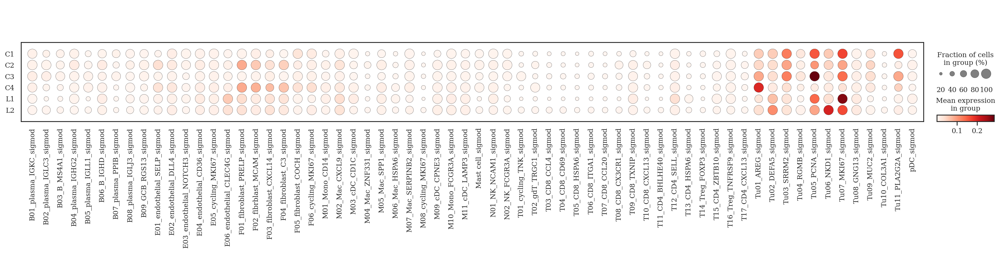

In [11]:
sc.pl.DotPlot(adata, [ct+"_sigmod" for ct in celltypesAll], 
              groupby='sample',cmap="Reds").show()

In [10]:
adata_tmp = sc.AnnData(theta_logit)
adata_tmp.obs["sample"] = adata_tmp.obs.index.str.split('_').str[0]

In [10]:
## Just use Cell proportion
sc.pp.neighbors(adata_tmp,use_rep='X',n_neighbors=50)
sc.tl.umap(adata_tmp)

2025-05-17 08:37:27.180152: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2025-05-17 08:37:28.390961: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT


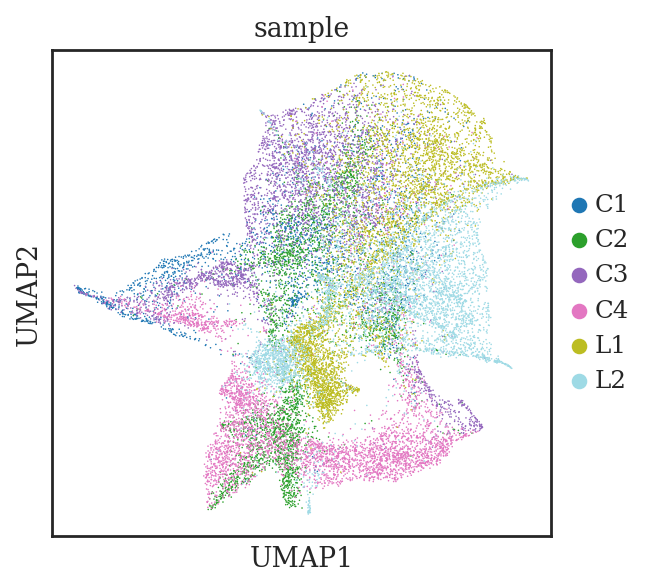

In [14]:
with plt.rc_context({'figure.figsize':(4,4)}):
    sc.pl.umap(
        adata_tmp,
        color="sample",
        size=2,
        palette="tab20",
        show = False,
        )
    plt.savefig("Figure/3_umap_cell_proportion.pdf",bbox_inches = "tight")

### Niche Distribution among UMAP plot derived from Cell Proportion

In [11]:
A_df = pd.read_csv("Results/SVLR/niche_res_topic15.csv",index_col=0)

In [14]:
all(A_df.index == adata.obs_names)

True

In [12]:
for i in range(15):
    column_name = "Niche" + str(i+1)
    adata_tmp.obs[column_name] = A_df.loc[ adata_tmp.obs.index,column_name]

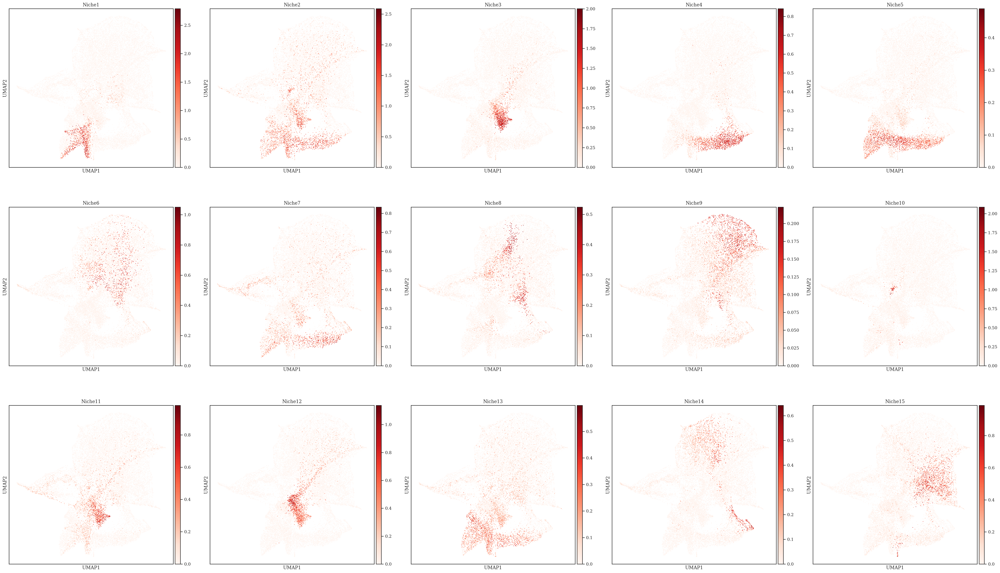

In [13]:
niches_for_plot = ["Niche" + str(i+1) for i in range(15)]
with plt.rc_context({'figure.figsize':(8,8)}):
    sc.pl.umap(
        adata_tmp,
        color=niches_for_plot,
        size=8,
        ncols=5,
        color_map="Reds",
        show=False,
    )
    plt.savefig("Figure/3_umap_niche_distributions.pdf",bbox_inches = "tight")


In [16]:
sc.tl.leiden(adata_tmp, resolution=0.8)

In [17]:
adata_tmp.obs["leiden"] = adata_tmp.obs["leiden"].astype(int)
adata_tmp.obs["hub"] = 'hub' + (adata_tmp.obs["leiden"] + 1).astype(str)

In [ ]:
# adata_tmp.write_h5ad("./Data/adata_theta_logit_umap.h5ad")

In [9]:
adata_tmp = sc.read_h5ad("./Data/adata_theta_logit_umap.h5ad")

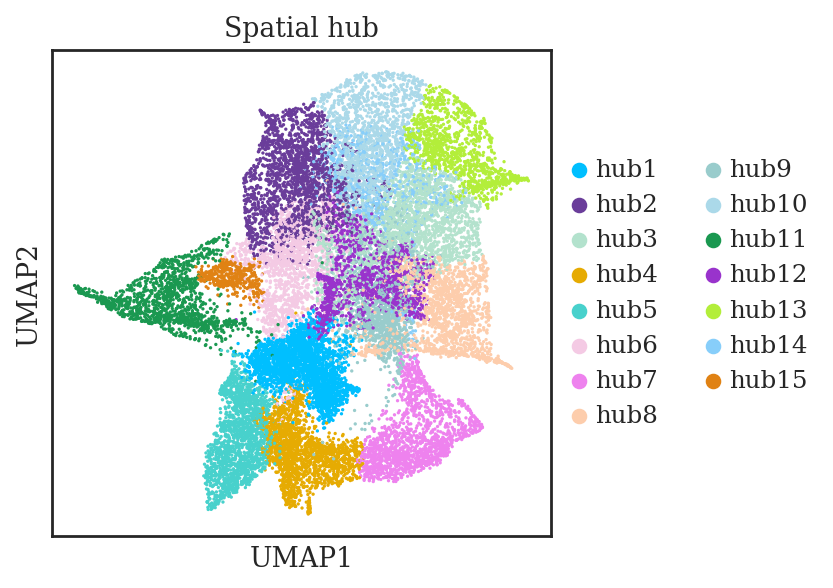

In [29]:
with plt.rc_context({'figure.figsize':(4,4)}):
    sc.pl.umap(adata_tmp, 
           color=['hub'], 
           size=9, 
           palette=palette,
           title = 'Spatial hub',
           show=False,
          )
    plt.savefig("Figure/3_3_umap_Spatial_Hub.pdf",bbox_inches = "tight")

In [10]:
adata.obs["hub"] = adata_tmp.obs['hub']

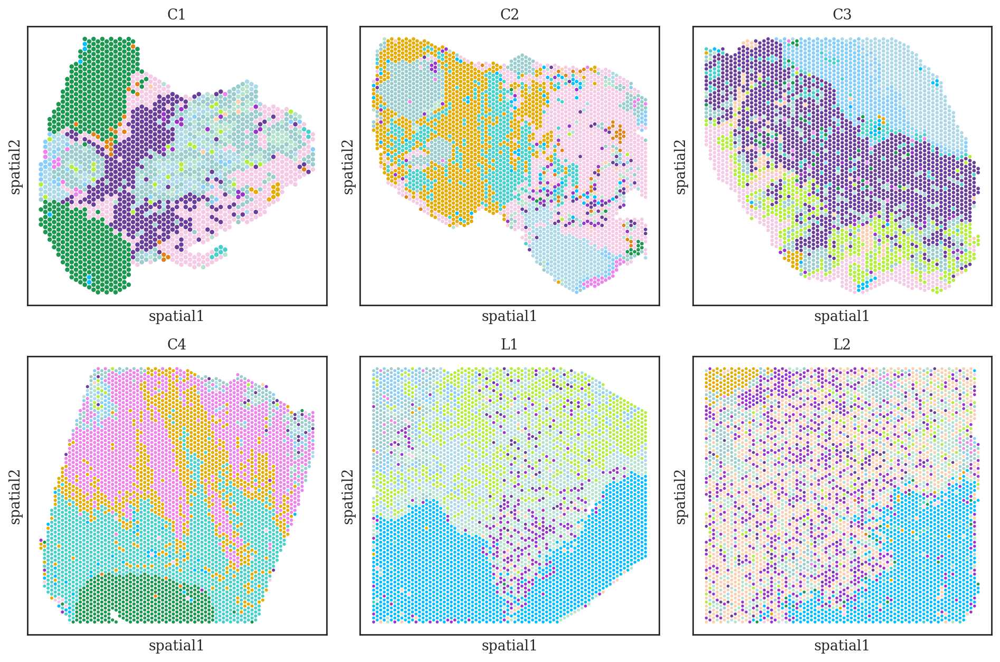

In [14]:
samples = adata.obs["sample"].unique()

n = len(samples)
rows = 2
cols = n // rows 
fig, axs = plt.subplots(rows, cols, figsize=(4 * cols, 4 * rows))
axs = axs.flatten()

for i, sample in enumerate(samples):
    ax = axs[i] if n > 1 else axs
    sc.pl.embedding(
        adata[adata.obs["sample"] == sample],
        color="hub",
        basis="spatial",
        title=sample,
        legend_loc = None,
        palette = palette,
        show=False, 
        ax=ax,
    )

plt.tight_layout()
plt.savefig("Figure/4_2_spatial_plot_hub.svg", dpi=300,bbox_inches='tight')
plt.show()

## Spatial hubs distribution among different conditions

In [8]:
ct_cnt = adata.obs.groupby(['sample','hub']).size().reset_index(name='count')
ct_cnt['prop'] = ct_cnt.groupby('sample')['count'].transform(lambda x: x / x.sum())
ct_cnt['condition'] = ct_cnt['sample'].str[0]

In [9]:
ct_cnt_wide = ct_cnt.pivot(
    index='sample',
    columns='hub',
    values='prop'
).fillna(0)

In [10]:
ct_cnt_wide

hub,hub1,hub2,hub3,hub4,hub5,hub6,hub7,hub8,hub9,hub10,hub11,hub12,hub13,hub14,hub15
sample,,,,,,,,,,,,,,,
C1,0.002921,0.179163,0.063291,0.004382,0.004382,0.187439,0.005842,0.002921,0.159688,0.080818,0.261928,0.007790,0.013145,0.015093,0.011198
C2,0.016036,0.016641,0.029047,0.256884,0.140998,0.291982,0.009077,0.008169,0.105295,0.080484,0.004236,0.016641,0.000908,0.011800,0.011800
C3,0.007609,0.383085,0.015803,0.000000,0.005853,0.043020,0.076968,0.006731,0.033948,0.084577,0.096283,0.009950,0.010828,0.119696,0.105648
C4,0.009462,0.005478,0.003984,0.208167,0.300299,0.004482,0.304283,0.000498,0.033865,0.005727,0.102092,0.001494,0.003237,0.015936,0.000996
L1,0.334118,0.014983,0.178296,0.001070,0.001284,0.003425,0.001926,0.011344,0.039384,0.122646,0.000214,0.057149,0.187500,0.046661,0.000000
L2,0.193912,0.026897,0.156380,0.020017,0.006672,0.012719,0.004170,0.284612,0.071935,0.008132,0.004379,0.175771,0.028148,0.005630,0.000626


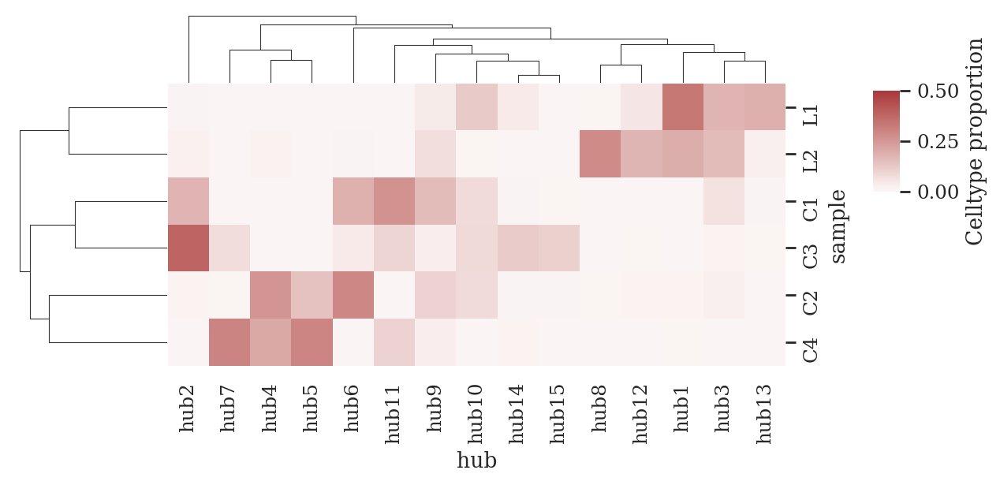

In [16]:
cg = sns.clustermap(
    ct_cnt_wide,
    cmap='vlag',
    center=0,
    vmin=0, vmax=0.5,
    row_cluster=True,
    col_cluster=True,
    figsize=(7, 4),
    cbar_kws={'label': 'Celltype proportion'}
)

cg.cax.set_position([1.00, 0.60, 0.03, 0.20])
plt.tight_layout()
plt.savefig("Figure/4_3_hub_distributions.pdf", bbox_inches='tight',dpi=300)
plt.show()

## Spatial Hub Function annotation and cell type proportions

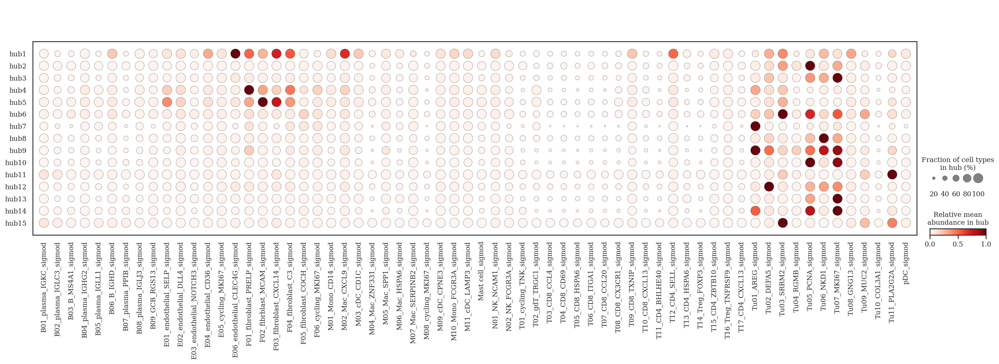

In [44]:
with plt.rc_context({'figure.figsize':(7,4)}):
    sc.pl.dotplot(adata, [ct+"_sigmod" for ct in celltypesAll], 
              groupby='hub',cmap="Reds",
              size_title = "Fraction of cell types\nin hub (%)",
              colorbar_title = "Relative mean\nabundance in hub",
              standard_scale = "group",
              show=False)
    plt.savefig("Figure/5_celltype_prop_dotplot.pdf",bbox_inches = "tight")

In [17]:
tumor_states = ['Tu01_AREG', 'Tu02_DEFA5', 'Tu03_SRRM2', 'Tu04_RGMB',
       'Tu05_PCNA', 'Tu06_NKD1', 'Tu07_MKI67', 'Tu08_GNG13', 'Tu09_MUC2',
       'Tu10_COL3A1', 'Tu11_PLA2G2A']
adata_tmp.obs['tumor_prop'] = 0

tumor_prop_df = pd.DataFrame(adata_tmp[:, tumor_states].X, index=adata_tmp.obs_names)
tumor_prop = tumor_prop_df.sum(axis=1)
adata_tmp.obs['tumor_prop'] = tumor_prop

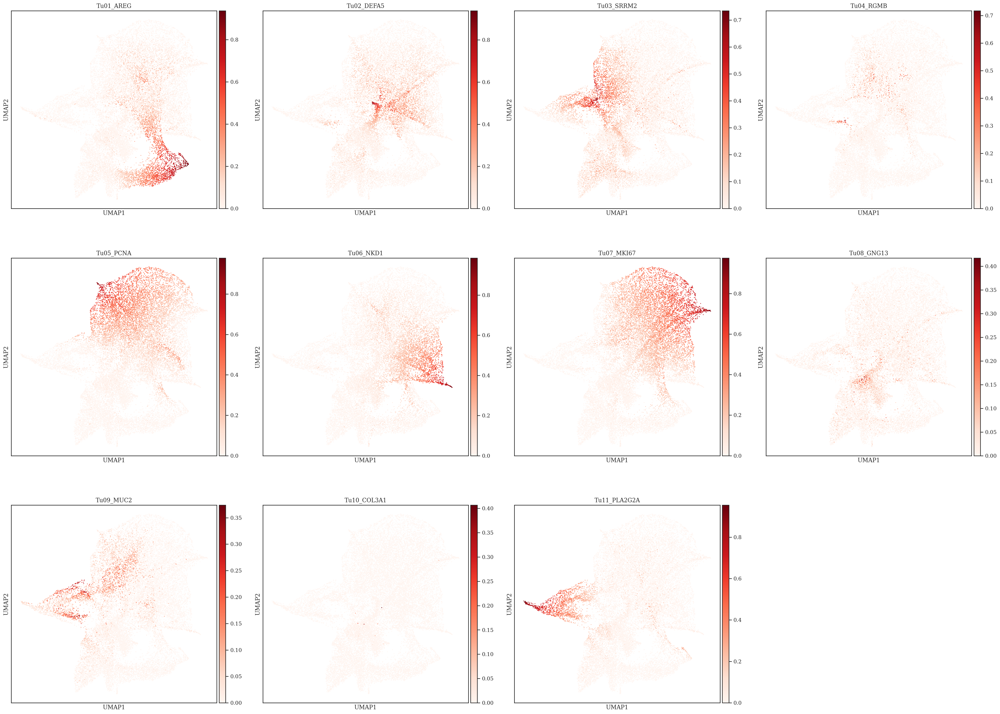

In [51]:
with plt.rc_context({'figure.figsize':(8,8)}):
    sc.pl.umap(
        adata_tmp,
        color=tumor_states,
        size=10,
        ncols=4,
        color_map="Reds",
        show=False
    )
    plt.savefig("Figure/5_2_umap_tumor_individual.pdf")

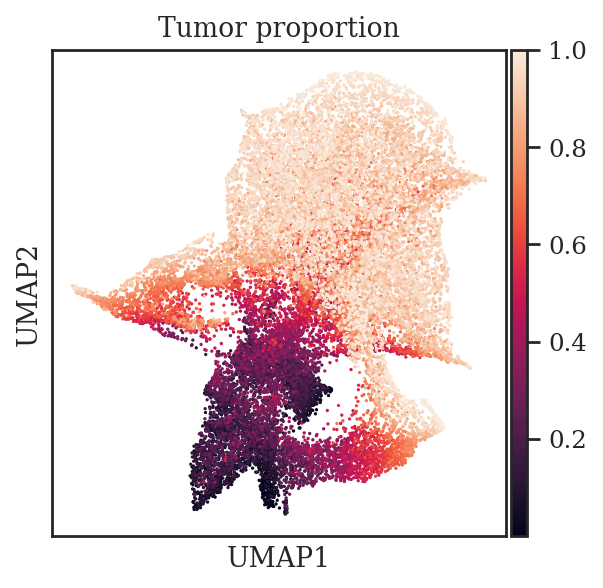

In [49]:
with plt.rc_context({'figure.figsize':(4,4)}):
    sc.pl.umap(adata_tmp, 
           color=['tumor_prop'], 
           size=9, 
           palette="Reds",
           title = 'Tumor proportion',
           show=False,
          )
    plt.savefig("Figure/5_1_umap_tumor_prop.pdf",bbox_inches = "tight")

In [11]:
sc.tl.rank_genes_groups(adata, groupby='hub' ,use_raw=False, method='wilcoxon')

In [126]:
gseapy.get_library_name(organism='Human')

['ARCHS4_Cell-lines',
 'ARCHS4_IDG_Coexp',
 'ARCHS4_Kinases_Coexp',
 'ARCHS4_TFs_Coexp',
 'ARCHS4_Tissues',
 'Achilles_fitness_decrease',
 'Achilles_fitness_increase',
 'Aging_Perturbations_from_GEO_down',
 'Aging_Perturbations_from_GEO_up',
 'Allen_Brain_Atlas_10x_scRNA_2021',
 'Allen_Brain_Atlas_down',
 'Allen_Brain_Atlas_up',
 'Azimuth_2023',
 'Azimuth_Cell_Types_2021',
 'BioCarta_2013',
 'BioCarta_2015',
 'BioCarta_2016',
 'BioPlanet_2019',
 'BioPlex_2017',
 'CCLE_Proteomics_2020',
 'CORUM',
 'COVID-19_Related_Gene_Sets',
 'COVID-19_Related_Gene_Sets_2021',
 'Cancer_Cell_Line_Encyclopedia',
 'CellMarker_2024',
 'CellMarker_Augmented_2021',
 'ChEA_2013',
 'ChEA_2015',
 'ChEA_2016',
 'ChEA_2022',
 'Chromosome_Location',
 'Chromosome_Location_hg19',
 'ClinVar_2019',
 'DGIdb_Drug_Targets_2024',
 'DSigDB',
 'Data_Acquisition_Method_Most_Popular_Genes',
 'DepMap_CRISPR_GeneDependency_CellLines_2023',
 'DepMap_WG_CRISPR_Screens_Broad_CellLines_2019',
 'DepMap_WG_CRISPR_Screens_Sanger_Cell

In [12]:
hubs = adata.uns['rank_genes_groups']['names'].dtype.names
gene_sets = 'KEGG_2021_Human'

enr_res_dict  = {}
for hub in hubs:

    df = sc.get.rank_genes_groups_df(adata, group=hub,log2fc_min=1, pval_cutoff=0.05,)
    glist = df['names'].squeeze().str.strip().tolist()
    print("Hub:{} Length:{}".format(hub, len(glist)))

    enr_res = gseapy.enrichr(gene_list=glist, organism='Human', gene_sets=gene_sets, cutoff = 0.05)

    enr_res_dict[hub] = enr_res.results

Hub:hub1 Length:867
Hub:hub2 Length:789
Hub:hub3 Length:51
Hub:hub4 Length:980
Hub:hub5 Length:583
Hub:hub6 Length:600
Hub:hub7 Length:752
Hub:hub8 Length:144
Hub:hub9 Length:332
Hub:hub10 Length:693
Hub:hub11 Length:1216
Hub:hub12 Length:44
Hub:hub13 Length:461
Hub:hub14 Length:656
Hub:hub15 Length:482


In [13]:
erh_long_list = []
for hub, df in enr_res_dict.items():
    df2 = (
        df[df['Adjusted P-value'] <= 1]
        [['Term','Adjusted P-value','Odds Ratio']]
        .assign(hub=hub)
    )
    erh_long_list.append(df2)

erh_long_df = pd.concat(erh_long_list, ignore_index=True)

erh_wide_df = (
    erh_long_df
    .pivot(index='Term', columns='hub', values='Adjusted P-value')
    .fillna(1)
)
erh_wide_df = erh_wide_df.clip(lower=1e-300)
erh_wide_df = -np.log10(erh_wide_df)

erh_odds_ratio = (
    erh_long_df
    .pivot(index='Term', columns='hub', values='Odds Ratio')
    .fillna(1)
)

In [14]:
clean_df = erh_wide_df.copy()

clean_df.index = clean_df.index.str.replace(r"\s*\(GO:[0-9]+\)$", "", regex=True)
max_len = 50
mask = clean_df.index.str.len() <= max_len
clean_df = clean_df[mask]

erh_odds_ratio.index = erh_odds_ratio.index.str.replace(r"\s*\(GO:[0-9]+\)$", "", regex=True)

In [15]:
selected_terms = set()
for hub in clean_df.columns:
    top3 = clean_df[hub].nlargest(3)
    selected_terms.update(top3.index)

filtered_erh_wide_df = clean_df.loc[clean_df.index.isin(selected_terms)]
filtered_erh_wide_df_odds = erh_odds_ratio.loc[erh_odds_ratio.index.isin(selected_terms)]
filtered_erh_wide_df = filtered_erh_wide_df[["hub"+str(i) for i in [2,7,4,5,6,11,9,10,14,15,8,12,1,3,13]]]
filtered_erh_wide_df_odds = filtered_erh_wide_df_odds[["hub"+str(i) for i in [2,7,4,5,6,11,9,10,14,15,8,12,1,3,13]]]


In [16]:
conditions = [
    filtered_erh_wide_df > 10,
    filtered_erh_wide_df > 5,
    filtered_erh_wide_df > 2,
    filtered_erh_wide_df > 1,
    filtered_erh_wide_df > 0,
    filtered_erh_wide_df == 0,
]
choices = [10,5, 3, 2, 0.5,0]

p_mat_dis = pd.DataFrame(
    np.select(conditions, choices, default=np.nan),
    index=filtered_erh_wide_df.index,
    columns=filtered_erh_wide_df.columns
)

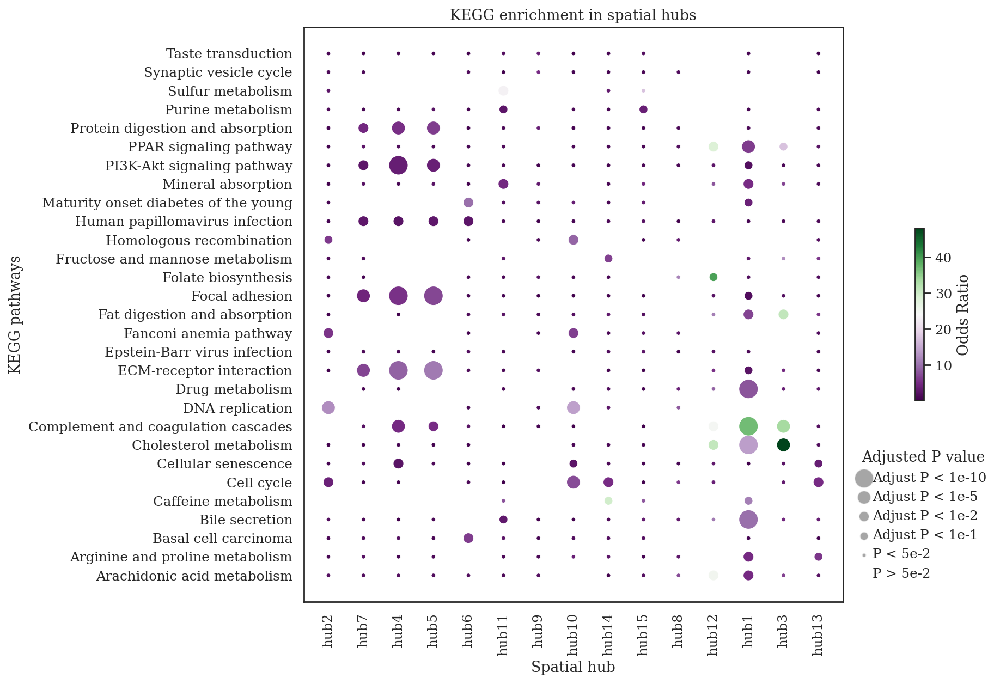

In [18]:
plt.figure(figsize=(12, 8))
group2_names = filtered_erh_wide_df.index
group1_names = filtered_erh_wide_df.columns

x, y = np.meshgrid(group1_names, group2_names)

x = x.flatten()
y = y.flatten()
exp_values = filtered_erh_wide_df_odds.values.flatten()
percent_values = p_mat_dis.values.flatten()

scatter = plt.scatter(x, y, c=exp_values, s=percent_values*25, cmap='PRGn',
                       alpha=1, edgecolors="w", linewidth=0.5)

plt.colorbar(scatter, label='Odds Ratio',pad=0.1,shrink=0.3)

legend_sizes = [10,5, 3, 2, 0.5,0]
legend_sizes_scaled = [size*25 for size in legend_sizes]
legend_labels = ["Adjust P < 1e-10",
                 "Adjust P < 1e-5",
                 "Adjust P < 1e-2",
                 "Adjust P < 1e-1",
                 "P < 5e-2",
                 "P > 5e-2"]

for size, scaled_size, label in zip(legend_sizes, legend_sizes_scaled, legend_labels):
    plt.scatter([], [], s=scaled_size, c='gray', alpha=0.7, edgecolors="w", label=label)

plt.legend(title='Adjusted P value', loc='center left', bbox_to_anchor=(1.01, 0.15), frameon=False)

plt.xlabel('Spatial hub')
plt.ylabel('KEGG pathways')
plt.title('KEGG enrichment in spatial hubs')

plt.xticks(np.arange(len(group1_names)), group1_names, rotation=90)
plt.yticks(np.arange(len(group2_names)), group2_names)

plt.tight_layout()
plt.savefig("Figure/6_spatial_hub_kegg.pdf",dpi=300)
plt.show()

Spatial Correlation analysis

In [ ]:
from SIGMOD import SIGMOD_CCI as cci
from SIGMOD import SIGMOD_plot as sigmod_plot

In [12]:
eta = pd.read_csv("./Results/SIGMOD/SIGMOD__eta_scaled.csv",index_col=0)
eta.index = ["Niche"+str(i+1) for i in range(15)]
eta_pos = eta.copy()
eta_pos[eta_pos<0] = 0

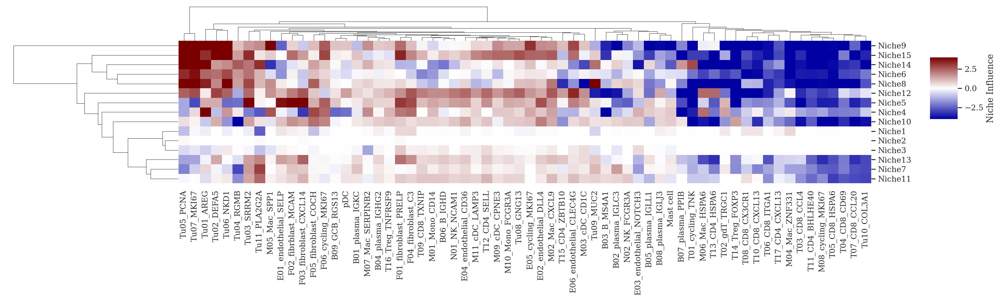

In [13]:
high_color = "#7A0000"
low_color = "#0000A3"
cmap = LinearSegmentedColormap.from_list(
    'niche_influence_cmap',
    [low_color, 'white', high_color]
)

# draw a clustered heatmap (rows & columns clustered)
cg = sns.clustermap(
    eta,
    cmap=cmap,
    center=0,
    vmin=-4, vmax=4,
    row_cluster=True,
    col_cluster=True,
    figsize=(18, 6),
    cbar_kws={'label': 'Niche Influence'}
)

cg.cax.set_position([1.01, 0.60, 0.03, 0.20])

plt.show()

# # save as PDF
cg.fig.savefig(
    "./Figure/7_scaled_eta.pdf",
    format='pdf',
    bbox_inches='tight'
)

# plt.show()

In [14]:
niche_construct = pd.read_csv('./Results/SVLR/lr_niche_topic15.csv',index_col=0)

In [15]:
lr_celltype = niche_construct.values @ eta
lr_celltype.index = niche_construct.index

In [16]:
ligands = [i[0] for i in lr_celltype.index.str.split("_")]
receptors = [i[1] for i in lr_celltype.index.str.split("_")]
ligands = list(set(ligands))
receptors = list(set(receptors))
lr = ligands.copy()
lr.extend(receptors)
lr = list(set(lr) & set(adata.var_names))

In [17]:
scdata = sc.read_h5ad('./Data/sc_combn.h5ad')

In [18]:
sc.pp.normalize_total(scdata)
sc.pp.log1p(scdata)

In [19]:
lr = list(set(lr) & set(scdata.var_names))

In [20]:
lr_effect = cci.get_lr_effect(niche_construct, eta_pos)
diff_lr = cci.get_diff_lr(scdata,"cluster",lr)
select_lr,l_exp,r_exp = cci.generate_matched_lr(lr_effect.T, diff_lr.T)
masked_r_exp = cci.mask_lr_effect(lr_effect.T,r_exp)

In [21]:
colors = [
    # B组 (紫色系)
    "#6A3D9A", "#9933CC", "#CC99FF", "#B2ABD2", "#9970AB", "#C2A5CF", "#5E4FA2", "#FF00CC", "#EE82EE",
    # E组 (蓝色系)
    "#00BFFF", "#87CEFA", "#0099FF", "#6495ED", "#3288BD", "#D1E5F0",
    # F组 (绿色系)
    "#1A9850", "#66C2A5", "#ABDDA4", "#66BD63", "#B3EE3A", "#99CCCC",
    # M组 (橙色系)
    "#E08214", "#FDC086", "#FF7F00", "#D6604D", "#B15928", "#8C510A", "#B35806", "#DFC27D", "#FBB4AE", "#FDCDAC", "#F1E2CC",
    # Mast cell
    "#E09991",
    # N组 (粉红色系)
    "#DE77AE", "#F4CAE4",
    # T组 (红色系)
    "#D6604D", "#9E0142", "#B15928", "#FBB4AE", "#D6604D", "#E08214", "#FDCDAC", "#9E0142", "#DE77AE", "#FF33CC", "#B35806", "#F1E2CC", "#D6604D", "#9E0142", "#DE77AE", "#F4CAE4", "#FF00CC",
    # Tu组 (黄色系)
    "#E6AB02", "#FFFF99", "#FFED6F", "#DFC27D", "#F6E8C3", "#E6AB02", "#FFFF99", "#FFED6F", "#DFC27D", "#F6E8C3", "#E6AB02",
    # pDC (灰蓝)
    "#8DA0CB"
]

celltypes = [
    "B01_plasma_IGKC", "B02_plasma_IGLC3", "B03_B_MS4A1", "B04_plasma_IGHG2", "B05_plasma_IGLL1", 
    "B06_B_IGHD", "B07_plasma_PPIB", "B08_plasma_IGLJ3", "B09_GCB_RGS13", 
    "E01_endothelial_SELP", "E02_endothelial_DLL4", "E03_endothelial_NOTCH3", "E04_endothelial_CD36", 
    "E05_cycling_MKI67", "E06_endothelial_CLEC4G", 
    "F01_fibroblast_PRELP", "F02_fibrblast_MCAM", "F03_fibroblast_CXCL14", "F04_fibroblast_C3", 
    "F05_fibroblast_COCH", "F06_cycling_MKI67", 
    "M01_Mono_CD14", "M02_Mac_CXCL9", "M03_cDC_CD1C", "M04_Mac_ZNF331", "M05_Mac_SPP1", 
    "M06_Mac_HSPA6", "M07_Mac_SERPINB2", "M08_cycling_MKI67", "M09_cDC_CPNE3", "M10_Mono_FCGR3A", 
    "M11_cDC_LAMP3", 
    "Mast cell",
    "N01_NK_NCAM1", "N02_NK_FCGR3A", 
    "T01_cycling_TNK", "T02_gdT_TRGC1", "T03_CD8_CCL4", "T04_CD8_CD69", "T05_CD8_HSPA6", 
    "T06_CD8_ITGA1", "T07_CD8_CCL20", "T08_CD8_CX3CR1", "T09_CD8_TXNIP", "T10_CD8_CXCL13", 
    "T11_CD4_BHLHE40", "T12_CD4_SELL", "T13_CD4_HSPA6", "T14_Treg_FOXP3", "T15_CD4_ZBTB10", 
    "T16_Treg_TNFRSF9", "T17_CD4_CXCL13", 
    "Tu01_AREG", "Tu02_DEFA5", "Tu03_SRRM2", "Tu04_RGMB", "Tu05_PCNA", "Tu06_NKD1", 
    "Tu07_MKI67", "Tu08_GNG13", "Tu09_MUC2", "Tu10_COL3A1", "Tu11_PLA2G2A", 
    "pDC"
]

celltypes_split =  [ct.split('_')[0] for ct in celltypes]

In [22]:
node_color_map = {}
for celltype, color in zip(celltypes_split,colors):
    node_color_map[celltype] = color

In [22]:
adata_L2 = adata[adata.obs["sample"] == "L2"]
theta_logit_L2 = theta_logit.loc[adata_L2.obs_names,]
pos = adata_L2.obs[['x','y']]

In [23]:
tau = cci.SE_kernel(X=pos.iloc[:, [0, 1]], length_scale=6/2)
spatial_corr_L2 = cci.compute_spatial_corr_matrix(theta_logit_L2,tau)

spatial_corr_L2_pos = spatial_corr_L2.copy()
spatial_corr_L2_pos[spatial_corr_L2_pos<0] = 0

Computing spatial correlations:   0%|          | 0/64 [00:00<?, ?it/s]

In [24]:
interaction_dict = cci.compute_interaction_dict(spatial_corr_L2_pos,l_exp,masked_r_exp)

In [25]:
mats = list(interaction_dict.values())

total_interaction = sum(mats[1:], mats[0])

In [32]:
total_interaction.index = total_interaction.index.str.replace(r'_.*', '', regex=True)
total_interaction.columns = total_interaction.columns.str.replace(r'_.*', '', regex=True)

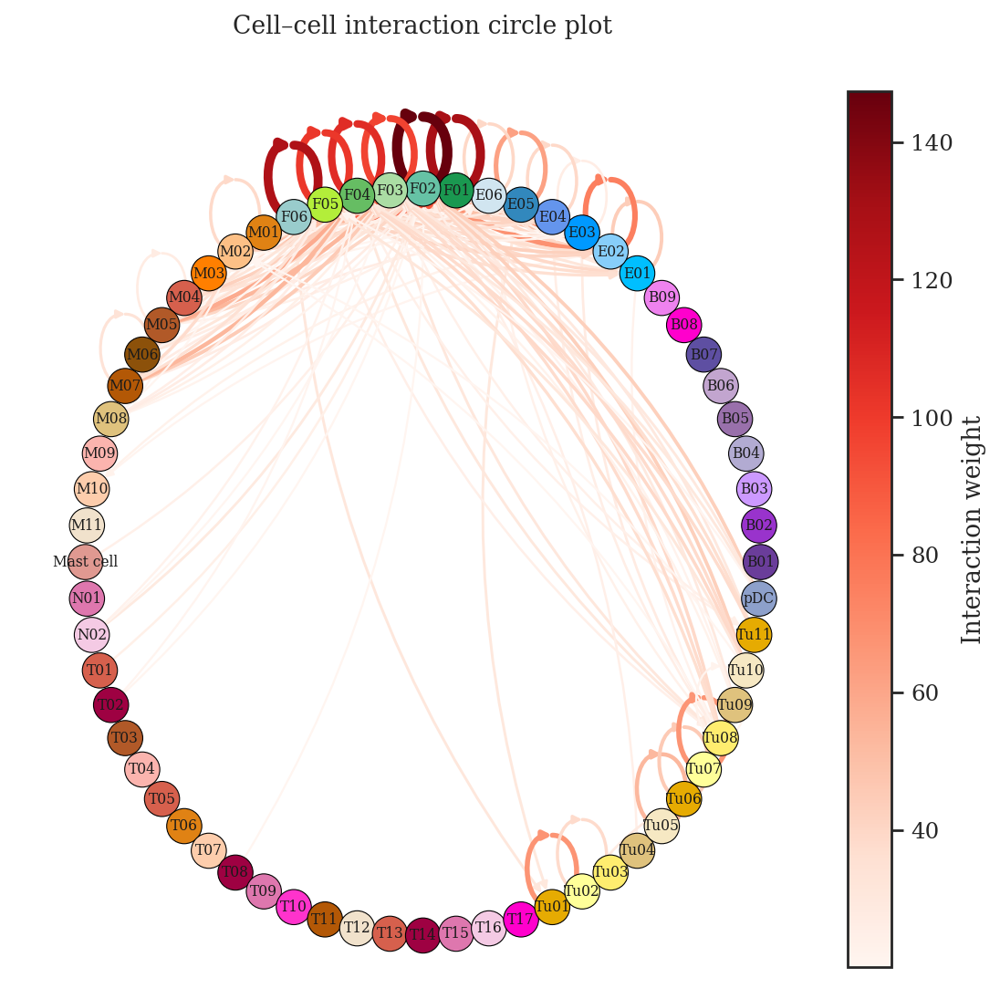

In [44]:
sigmod_plot.plot_circle_interactions(total_interaction,node_color_map,threshold = 20,
                                     edge_cmap="Reds",max_width=5,min_width=1,
                                     node_size=300,font_size=7,figsize = (7,7),
                                     file_name="Figure/7_1_L2_TotalInteraction.pdf")

In [24]:
adata_L1 = adata[adata.obs["sample"] == "L1"]
theta_logit_L1 = theta_logit.loc[adata_L1.obs_names,]
pos = adata_L1.obs[['x','y']]

tau = cci.SE_kernel(X=pos.iloc[:, [0, 1]], length_scale=6/2)
spatial_corr_L1 = cci.compute_spatial_corr_matrix(theta_logit_L1,tau)

spatial_corr_L1_pos = spatial_corr_L1.copy()
spatial_corr_L1_pos[spatial_corr_L1_pos<0] = 0

interaction_dict = cci.compute_interaction_dict(spatial_corr_L1_pos,l_exp,masked_r_exp)

Computing spatial correlations:   0%|          | 0/64 [00:00<?, ?it/s]

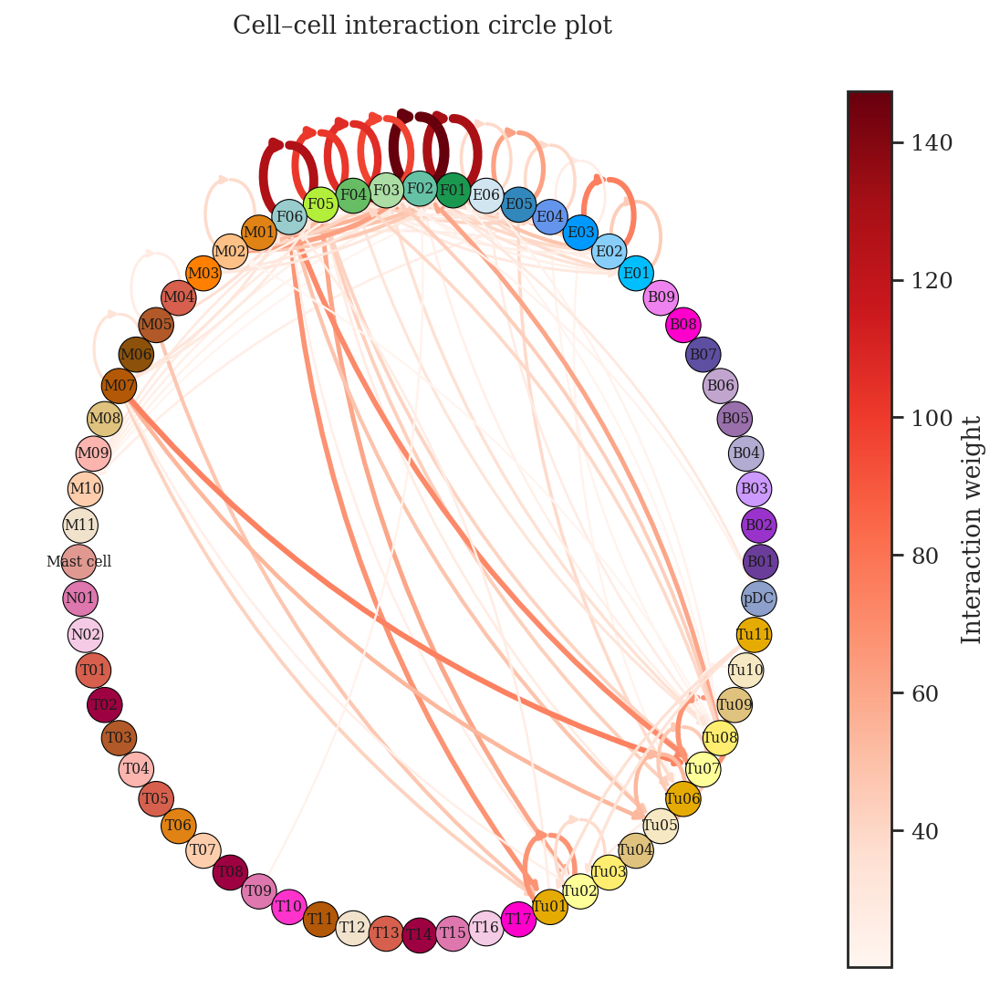

In [46]:
mats = list(interaction_dict.values())

total_interaction = sum(mats[1:], mats[0])
total_interaction.index = total_interaction.index.str.replace(r'_.*', '', regex=True)
total_interaction.columns = total_interaction.columns.str.replace(r'_.*', '', regex=True)

sigmod_plot.plot_circle_interactions(total_interaction,node_color_map,threshold = 20,
                                     edge_cmap="Reds",max_width=5,min_width=1,
                                     node_size=300,font_size=7,figsize = (7,7),
                                     file_name="Figure/7_2_L1_TotalInteraction.pdf")

In [25]:
adata_C1 = adata[adata.obs["sample"] == "C1"]
theta_logit_C1 = theta_logit.loc[adata_C1.obs_names,]
pos = adata_C1.obs[['x','y']]

tau = cci.SE_kernel(X=pos.iloc[:, [0, 1]], length_scale=6/2)
spatial_corr_C1 = cci.compute_spatial_corr_matrix(theta_logit_C1,tau)

spatial_corr_C1_pos = spatial_corr_C1.copy()
spatial_corr_C1_pos[spatial_corr_C1_pos<0] = 0

interaction_dict = cci.compute_interaction_dict(spatial_corr_C1_pos,l_exp,masked_r_exp)

Computing spatial correlations:   0%|          | 0/64 [00:00<?, ?it/s]

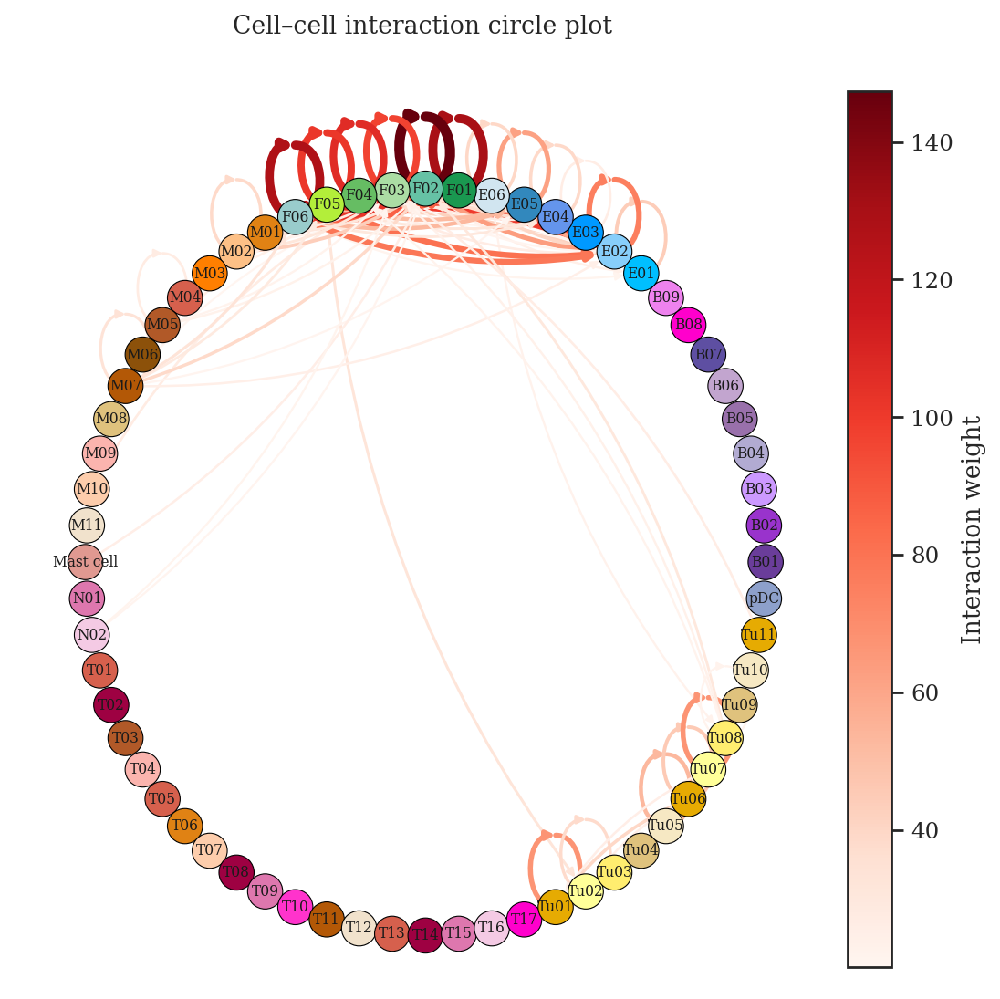

In [48]:
mats = list(interaction_dict.values())

total_interaction = sum(mats[1:], mats[0])
total_interaction.index = total_interaction.index.str.replace(r'_.*', '', regex=True)
total_interaction.columns = total_interaction.columns.str.replace(r'_.*', '', regex=True)

sigmod_plot.plot_circle_interactions(total_interaction,node_color_map,threshold = 20,
                                     edge_cmap="Reds",max_width=5,min_width=1,
                                     node_size=300,font_size=7,figsize = (7,7),
                                     file_name="Figure/7_3_C1_TotalInteraction.pdf")

In [26]:
adata_C2 = adata[adata.obs["sample"] == "C2"]
theta_logit_C2 = theta_logit.loc[adata_C2.obs_names,]
pos = adata_C2.obs[['x','y']]

tau = cci.SE_kernel(X=pos.iloc[:, [0, 1]], length_scale=6/2)
spatial_corr_C2 = cci.compute_spatial_corr_matrix(theta_logit_C2,tau)

spatial_corr_C2_pos = spatial_corr_C2.copy()
spatial_corr_C2_pos[spatial_corr_C2_pos<0] = 0

interaction_dict = cci.compute_interaction_dict(spatial_corr_C2_pos,l_exp,masked_r_exp)

Computing spatial correlations:   0%|          | 0/64 [00:00<?, ?it/s]

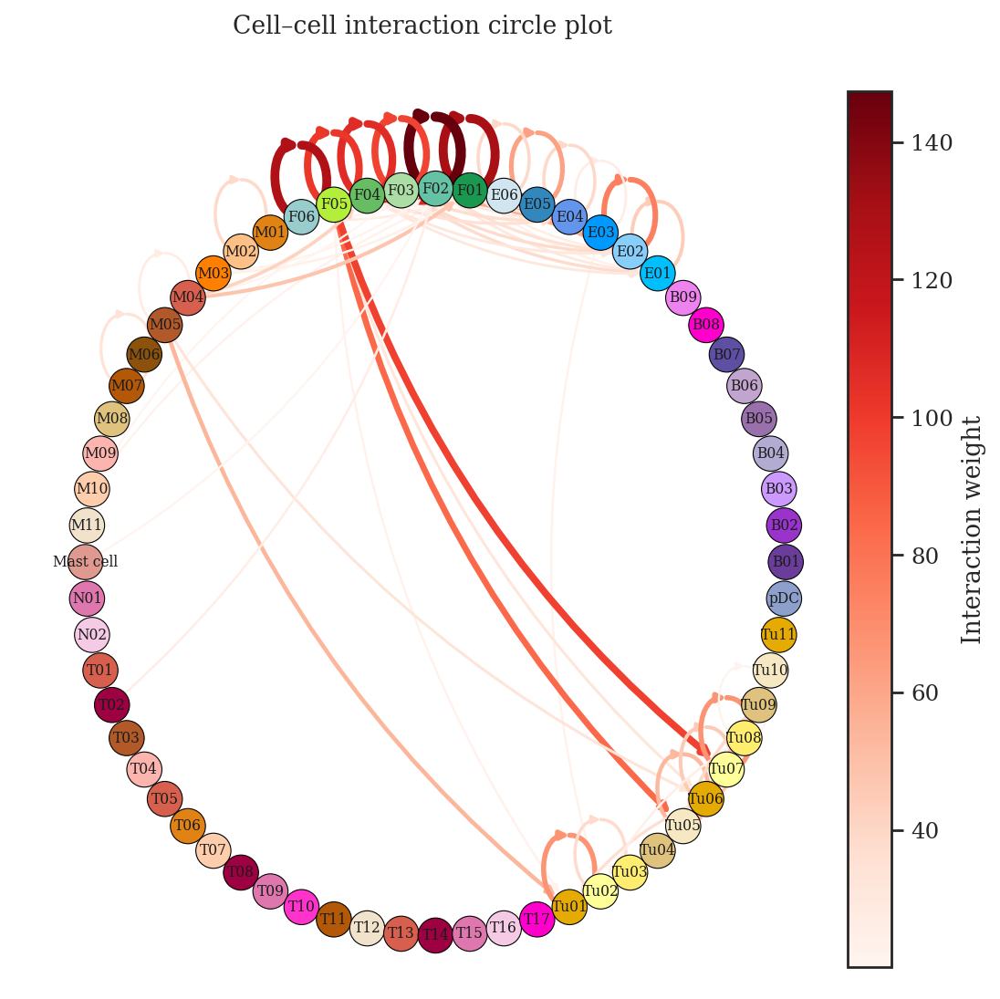

In [50]:
mats = list(interaction_dict.values())

total_interaction = sum(mats[1:], mats[0])
total_interaction.index = total_interaction.index.str.replace(r'_.*', '', regex=True)
total_interaction.columns = total_interaction.columns.str.replace(r'_.*', '', regex=True)

sigmod_plot.plot_circle_interactions(total_interaction,node_color_map,threshold = 20,
                                     edge_cmap="Reds",max_width=5,min_width=1,
                                     node_size=300,font_size=7,figsize = (7,7),
                                     file_name="Figure/7_4_C2_TotalInteraction.pdf")

In [27]:
adata_C3 = adata[adata.obs["sample"] == "C3"]
theta_logit_C3 = theta_logit.loc[adata_C3.obs_names,]
pos = adata_C3.obs[['x','y']]

tau = cci.SE_kernel(X=pos.iloc[:, [0, 1]], length_scale=6/2)
spatial_corr_C3 = cci.compute_spatial_corr_matrix(theta_logit_C3,tau)

spatial_corr_C3_pos = spatial_corr_C3.copy()
spatial_corr_C3_pos[spatial_corr_C3_pos<0] = 0

interaction_dict = cci.compute_interaction_dict(spatial_corr_C3_pos,l_exp,masked_r_exp)

Computing spatial correlations:   0%|          | 0/64 [00:00<?, ?it/s]

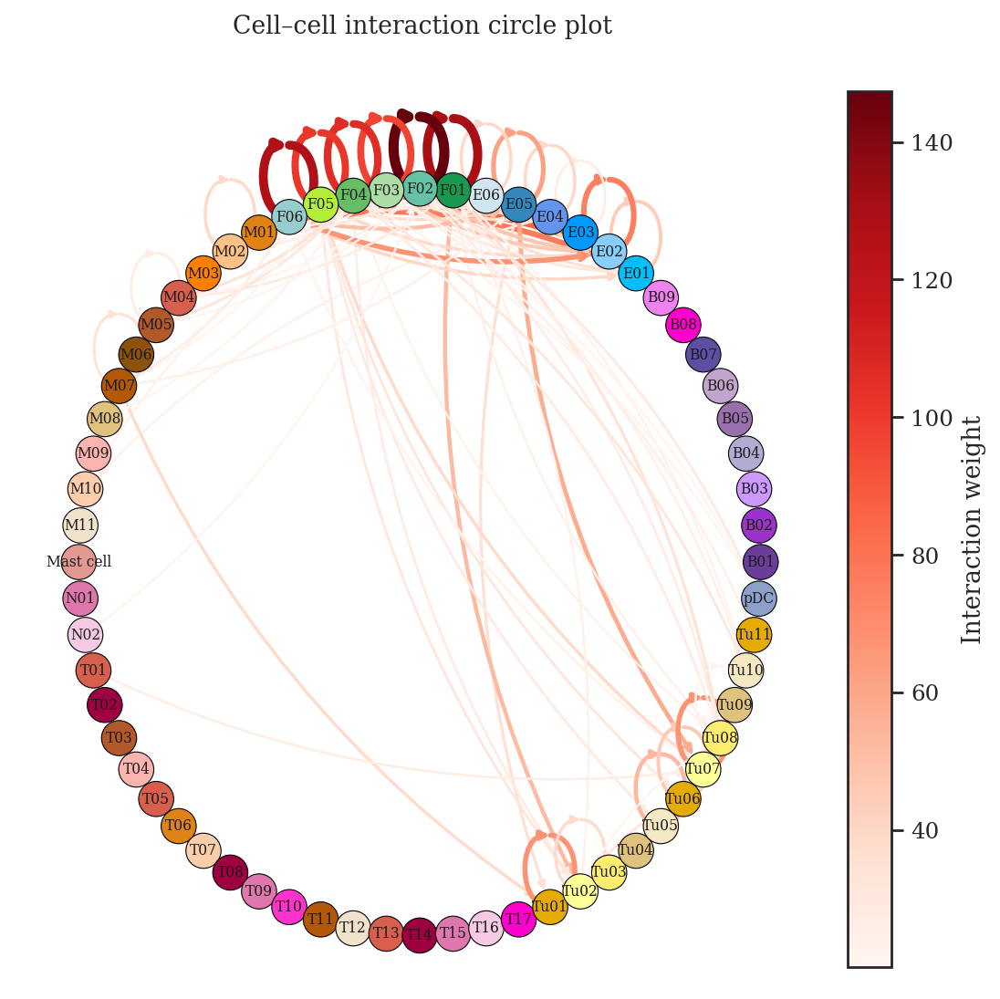

In [52]:
mats = list(interaction_dict.values())

total_interaction = sum(mats[1:], mats[0])
total_interaction.index = total_interaction.index.str.replace(r'_.*', '', regex=True)
total_interaction.columns = total_interaction.columns.str.replace(r'_.*', '', regex=True)

sigmod_plot.plot_circle_interactions(total_interaction,node_color_map,threshold = 20,
                                     edge_cmap="Reds",max_width=5,min_width=1,
                                     node_size=300,font_size=7,figsize = (7,7),
                                     file_name="Figure/7_5_C3_TotalInteraction.pdf")

In [28]:
adata_C4 = adata[adata.obs["sample"] == "C4"]
theta_logit_C4 = theta_logit.loc[adata_C4.obs_names,]
pos = adata_C4.obs[['x','y']]

tau = cci.SE_kernel(X=pos.iloc[:, [0, 1]], length_scale=6/2)
spatial_corr_C4 = cci.compute_spatial_corr_matrix(theta_logit_C4,tau)

spatial_corr_C4_pos = spatial_corr_C4.copy()
spatial_corr_C4_pos[spatial_corr_C4_pos<0] = 0

interaction_dict = cci.compute_interaction_dict(spatial_corr_C4_pos,l_exp,masked_r_exp)

Computing spatial correlations:   0%|          | 0/64 [00:00<?, ?it/s]

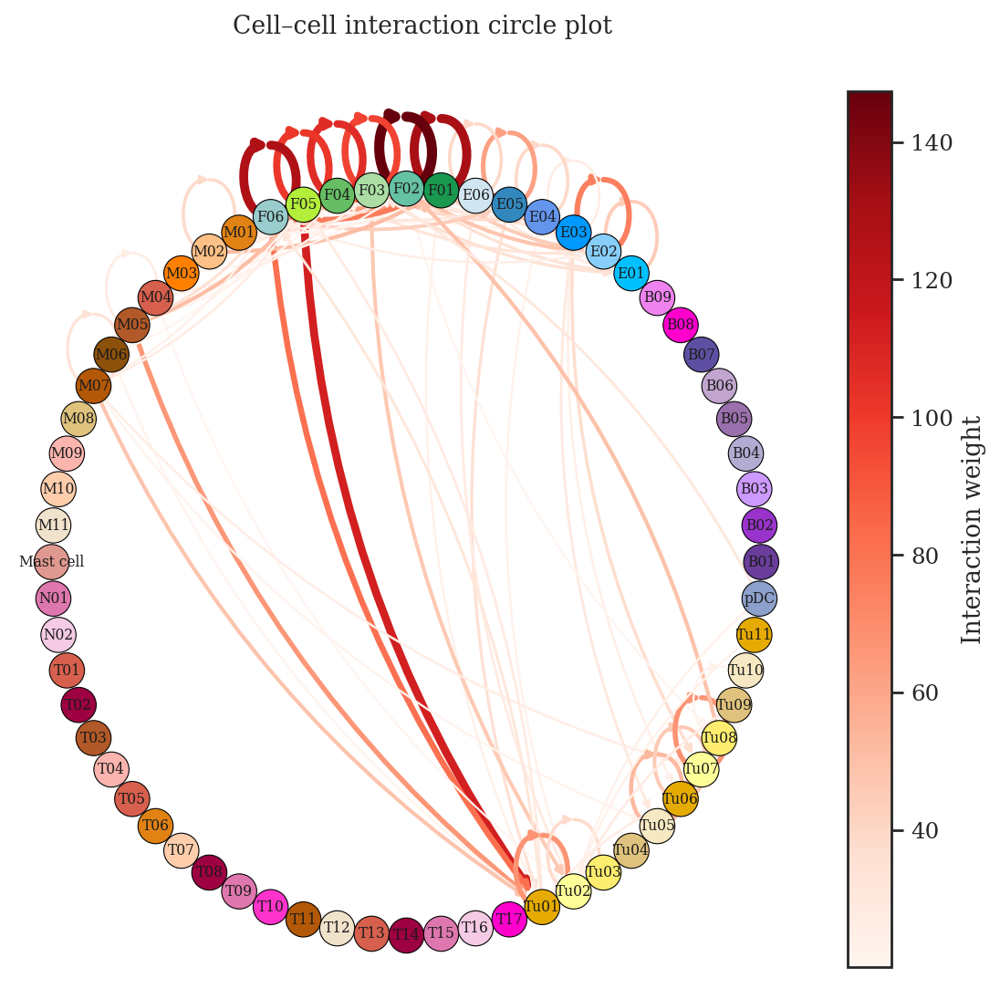

In [54]:
mats = list(interaction_dict.values())

total_interaction = sum(mats[1:], mats[0])
total_interaction.index = total_interaction.index.str.replace(r'_.*', '', regex=True)
total_interaction.columns = total_interaction.columns.str.replace(r'_.*', '', regex=True)

sigmod_plot.plot_circle_interactions(total_interaction,node_color_map,threshold = 20,
                                     edge_cmap="Reds",max_width=5,min_width=1,
                                     node_size=300,font_size=7,figsize = (7,7),
                                     file_name="Figure/7_6_C4_TotalInteraction.pdf")

In [ ]:
adj_results = {"C1":spatial_corr_C1_pos,
               "C2":spatial_corr_C2_pos,
               "C3":spatial_corr_C3_pos,
               "C4":spatial_corr_C4_pos,
               "L1":spatial_corr_L1_pos,
               "L2":spatial_corr_L2_pos}

In [ ]:
# with open('Results/adj_results.pickle', 'wb') as f:
#     pickle.dump(adj_results, f)

In [23]:
with open('Results/adj_results.pickle', 'rb') as f:
    adj_results = pickle.load(f)

## Differential Interaction analysis

In [24]:
total_interaction_dict = {}
for sample in ["C1","C2","C3","C4","L1","L2"]:
    interaction_dict = cci.compute_interaction_dict(adj_results[sample],l_exp,masked_r_exp)
    mats = list(interaction_dict.values())
    total_interaction = sum(mats[1:], mats[0])
    total_interaction_dict[sample] = total_interaction

In [25]:
keys = list(total_interaction_dict.keys())
dfs_list = [total_interaction_dict[k] for k in keys]

idx, cols = dfs_list[0].index, dfs_list[0].columns
n_rows, n_cols = len(idx), len(cols)

arr = np.stack([df.values for df in dfs_list], axis=0)

g1 = arr[:4, :, :]
g2 = arr[4:, :, :]

mean1 = g1.mean(axis=0)
mean2 = g2.mean(axis=0)
diff = mean2 - mean1

g1_flat = g1.reshape(4, -1)
g2_flat = g2.reshape(2, -1)

tstat, pvals_flat = ttest_ind(g1_flat, g2_flat, axis=0, equal_var=False)

pvals = pvals_flat.reshape(n_rows, n_cols)

diff_df  = pd.DataFrame(diff,  index=idx, columns=cols)
pval_df  = pd.DataFrame(pvals, index=idx, columns=cols)
pval_df = pval_df.fillna(1.0)

sig_diff = diff_df.where(pval_df < 0.05)
sig_diff = sig_diff.fillna(0)


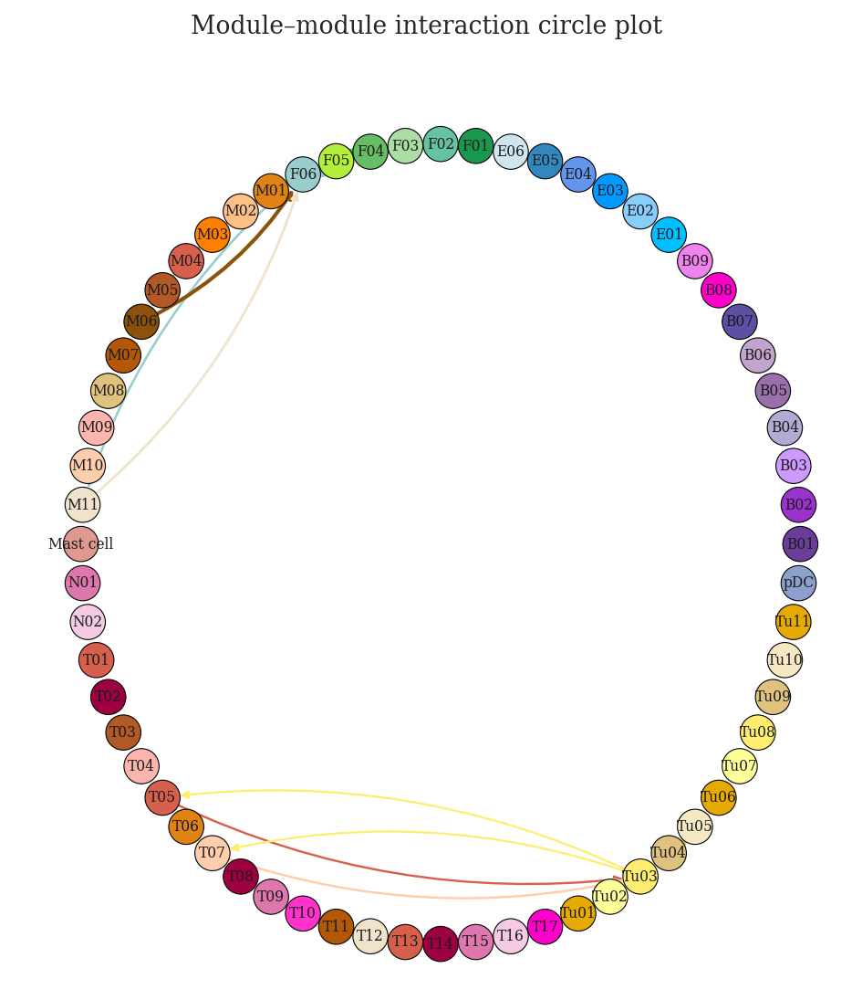

In [34]:
sig_diff.index = sig_diff.index.str.replace(r'_.*', '', regex=True)
sig_diff.columns = sig_diff.columns.str.replace(r'_.*', '', regex=True)
sigmod_plot.plot_circle_interactions(sig_diff,node_color_map,threshold = 0, # L vs C > 20
                                     edge_cmap="Reds",max_width=5,min_width=1,
                                     node_size=300,font_size=7,figsize = (6,7),
                                     file_name="Figure/8_2_differential_inter_C_L.pdf")

In [35]:

total_interaction_dict = {}
for sample in ["C1","C2","C3","C4","L1","L2"]:
    interaction_dict = cci.compute_interaction_dict(adj_results[sample],l_exp,masked_r_exp)
    mats = list(interaction_dict.values())
    total_interaction = sum(mats[1:], mats[0])
    total_interaction_dict[sample] = total_interaction.sum(axis=0)
    # total_interaction_dict[sample] = total_interaction.loc[:,"M02_Mac_CXCL9"]
    # total_interaction_dict[sample] = adj_results[sample].loc[:,"M02_Mac_CXCL9"]

total_interaction_df = pd.DataFrame(total_interaction_dict)
# total_interaction_df.drop('M02_Mac_CXCL9', inplace=True)

<Figure size 400x400 with 0 Axes>

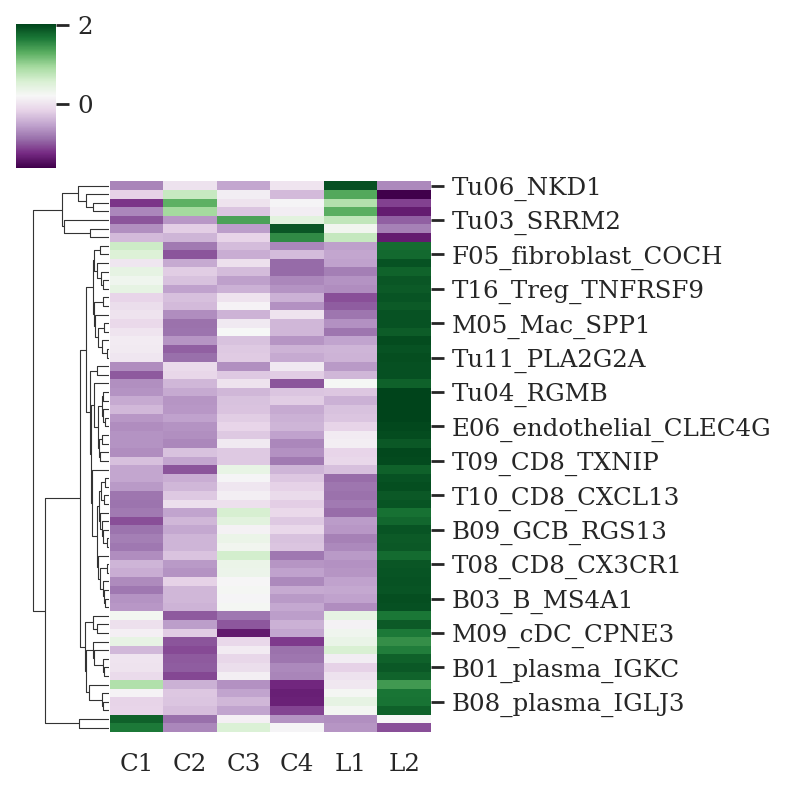

In [26]:
plt.figure(figsize = (5,5))
sns.clustermap(total_interaction_df,cmap='PRGn',z_score =0,col_cluster=False,figsize = (5,5))

In [27]:
total_interaction_dict = {}
for sample in ["C1","C2","C3","C4","L1","L2"]:
    interaction_dict = cci.compute_interaction_dict(adj_results[sample],l_exp,masked_r_exp)
    mats = list(interaction_dict.values())
    total_interaction = sum(mats[1:], mats[0])
    total_interaction_dict[sample] = total_interaction.sum(axis=1)
    # total_interaction_dict[sample] = total_interaction.loc["M02_Mac_CXCL9",:]
    # total_interaction_dict[sample] = adj_results[sample].loc[:,"M02_Mac_CXCL9"]

total_interaction_df = pd.DataFrame(total_interaction_dict)
# total_interaction_df.drop('M02_Mac_CXCL9', inplace=True)

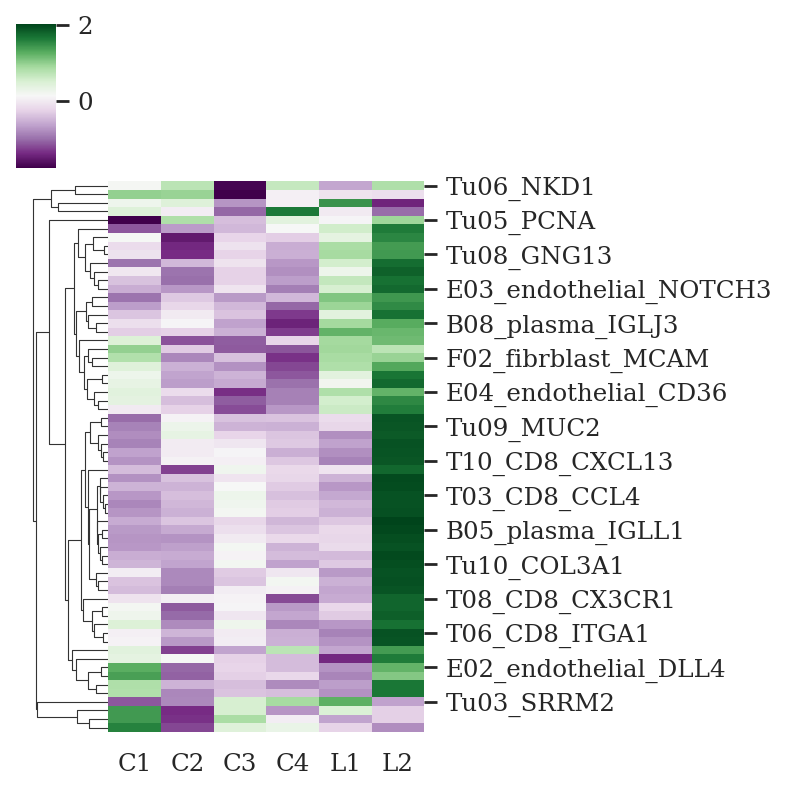

In [28]:
sns.clustermap(total_interaction_df,cmap='PRGn',z_score =0,col_cluster=False,figsize=(5,5))

In [29]:
ingoing = {}
outgoing = {}
for sample in ["C1","C2","C3","C4","L1","L2"]:
    interaction_dict = cci.compute_interaction_dict(adj_results[sample],l_exp,masked_r_exp)
    mats = list(interaction_dict.values())
    total_interaction = sum(mats[1:], mats[0])
    ingoing[sample] = total_interaction.sum(axis=1)
    outgoing[sample] = total_interaction.sum(axis=0)

ingoing = pd.DataFrame(ingoing)
outgoing = pd.DataFrame(outgoing)

In [42]:
ingoing_norm = ingoing.div(ingoing.sum(axis=1), axis=0)
outgoing_norm = outgoing.div(outgoing.sum(axis=1), axis=0)

In [63]:
ingoing_melt = pd.melt(ingoing,ignore_index=False,value_name="ingoing",var_name="Sample")
ingoing_melt["Cluster"] = ingoing_melt.index
outgoing_melt = pd.melt(outgoing,ignore_index=False,value_name="outgoing",var_name="Sample")
outgoing_melt["Cluster"] = outgoing_melt.index

In [64]:
in_out = ingoing_melt.merge(outgoing_melt,on = ["Sample","Cluster"])

In [65]:
in_out[in_out.Cluster == "M02_Mac_CXCL9"]

,Sample,ingoing,Cluster,outgoing
22,C1,354.767628,M02_Mac_CXCL9,542.853326
86,C2,146.349117,M02_Mac_CXCL9,179.489414
150,C3,154.244790,M02_Mac_CXCL9,229.245693
214,C4,265.661020,M02_Mac_CXCL9,301.847740
278,L1,408.919322,M02_Mac_CXCL9,584.442925
342,L2,443.929582,M02_Mac_CXCL9,943.277900


In [66]:
in_out.sort_values("outgoing").tail(10)

,Sample,ingoing,Cluster,outgoing
274,L1,756.745927,F04_fibroblast_C3,945.750196
20,C1,787.453521,F06_cycling_MKI67,947.989135
271,L1,689.029829,F01_fibroblast_PRELP,978.729432
339,L2,766.614902,F05_fibroblast_COCH,1129.479186
144,C3,559.151138,F02_fibrblast_MCAM,1281.864276
337,L2,818.133648,F03_fibroblast_CXCL14,1414.518833
272,L1,728.131669,F02_fibrblast_MCAM,1466.828390
16,C1,720.704530,F02_fibrblast_MCAM,1480.034530
338,L2,844.756711,F04_fibroblast_C3,1520.198690
336,L2,741.074501,F02_fibrblast_MCAM,1907.741740


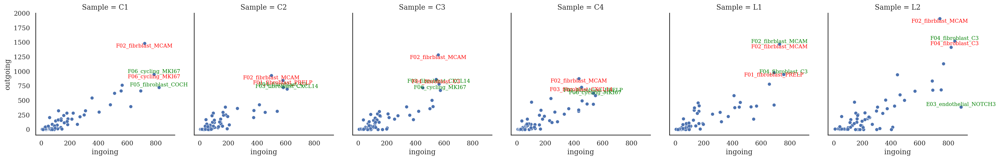

In [67]:
g = sns.FacetGrid(in_out, col='Sample', col_wrap=6, height=4)
g.map_dataframe(sns.scatterplot, x='ingoing', y='outgoing', palette="Set3", hue=None)

for ax, sample in zip(g.axes.flat, sorted(in_out['Sample'].unique())):
    df = in_out[in_out['Sample'] == sample]
    top5_ing = df.nlargest(2, 'ingoing')
    top5_out = df.nlargest(2, 'outgoing')
    
    for _, row in top5_ing.iterrows():
        ax.text(row['ingoing'], row['outgoing'], row['Cluster'],
                color='green', fontsize=9, ha='center', va='bottom')
    for _, row in top5_out.iterrows():
        ax.text(row['ingoing'], row['outgoing'], row['Cluster'],
                color='red', fontsize=9, ha='center', va='top')

plt.tight_layout()
plt.show()

## Communication Patterns

In [ ]:
ingoing = {}
outgoing = {}
for sample in ["C1","C2","C3","C4","L1","L2"]:
    
    interaction_dict = cci.compute_interaction_dict(adj_results[sample],l_exp,masked_r_exp)

    result = pd.DataFrame({
        key: df.sum(axis=1)
        for key, df in interaction_dict.items()
        })
    ingoing[sample] = result

    result = pd.DataFrame({
        key: df.sum(axis=0)
        for key, df in interaction_dict.items()
        })
    outgoing[sample] = result

In [76]:
ingoing_patterns = {}
outgoing_patterns = {}
for k,v in ingoing.items():

    model = NMF(n_components=5, init='random', random_state=0)
    A_ = model.fit_transform(v)
    ingoing_patterns[k] = pd.DataFrame(A_,
                                       columns=["Pattern" + str(i+1) for i in range(5)], 
                                       index=v.index)

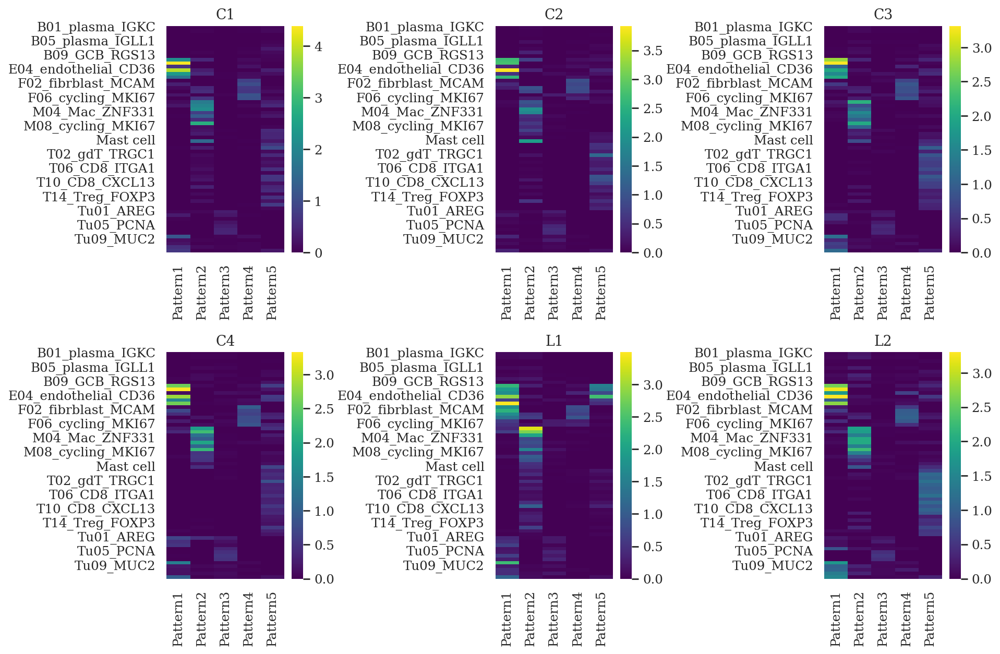

In [ ]:
n = 6
ncols = 3
nrows = math.ceil(n / ncols)

fig, axes = plt.subplots(
    nrows, ncols,
    figsize=(4 * ncols, 4 * nrows),
    squeeze=False
)

for ax, (name, df) in zip(axes.flat, ingoing_patterns.items()):

    sns.heatmap(
        df,
        ax=ax,
        cmap='viridis',
        cbar=True
    )
    ax.set_title(name)
    ax.set_xlabel('')
    ax.set_ylabel('')

for ax in axes.flat[n:]:
    ax.axis('off')

plt.tight_layout()
plt.show()

## Given cell type and draw specific gene

In [26]:
total_interaction_dict = {}
for sample in ["C1","C2","C3","C4","L1","L2"]:
    interaction_dict = cci.compute_interaction_dict(adj_results[sample],l_exp,masked_r_exp)
    result = (
    pd.concat(interaction_dict)
      .stack()
      .reset_index(name='value')
      .rename(columns={
          'level_0': 'LR',
          'level_1': 'source',
          'level_2': 'target'
      })
      )
    total_interaction_dict[sample] = result

In [41]:
mask = sig_diff > 20 # 20 for C vs L

mask_df = (
    mask
    .stack()
    .reset_index(name='keep')
    .query('keep')
    .drop(columns='keep')
)
mask_df.columns = ["source","target"]
filtered = (
    total_interaction_dict["L2"]
    .merge(mask_df, on=['source','target'], how='inner')
)
filtered['source_'] = filtered['source'].str.replace(
    r'^([^_]+)_[^_]+_([^_]+)$',
    r'\1_\2',
    regex=True
)
filtered['target_'] = filtered['target'].str.replace(
    r'^([^_]+)_[^_]+_([^_]+)$',
    r'\1_\2',
    regex=True
)

In [50]:
filtered = filtered[filtered.value >2] # 2 for L
filtered["cellpair"] = filtered["source_"] + "-" + filtered["target_"]

In [51]:
filtered[filtered.LR.str.contains("DDR1")]

,LR,source,target,value,source_,target_,cellpair
21311,COL3A1_DDR1,F04_fibroblast_C3,M02_Mac_CXCL9,2.042371,F04_C3,M02_CXCL9,F04_C3-M02_CXCL9


In [52]:
filtered_wide = pd.pivot(filtered,index="cellpair",columns="LR",values="value",)
filtered_wide = filtered_wide.fillna(0)

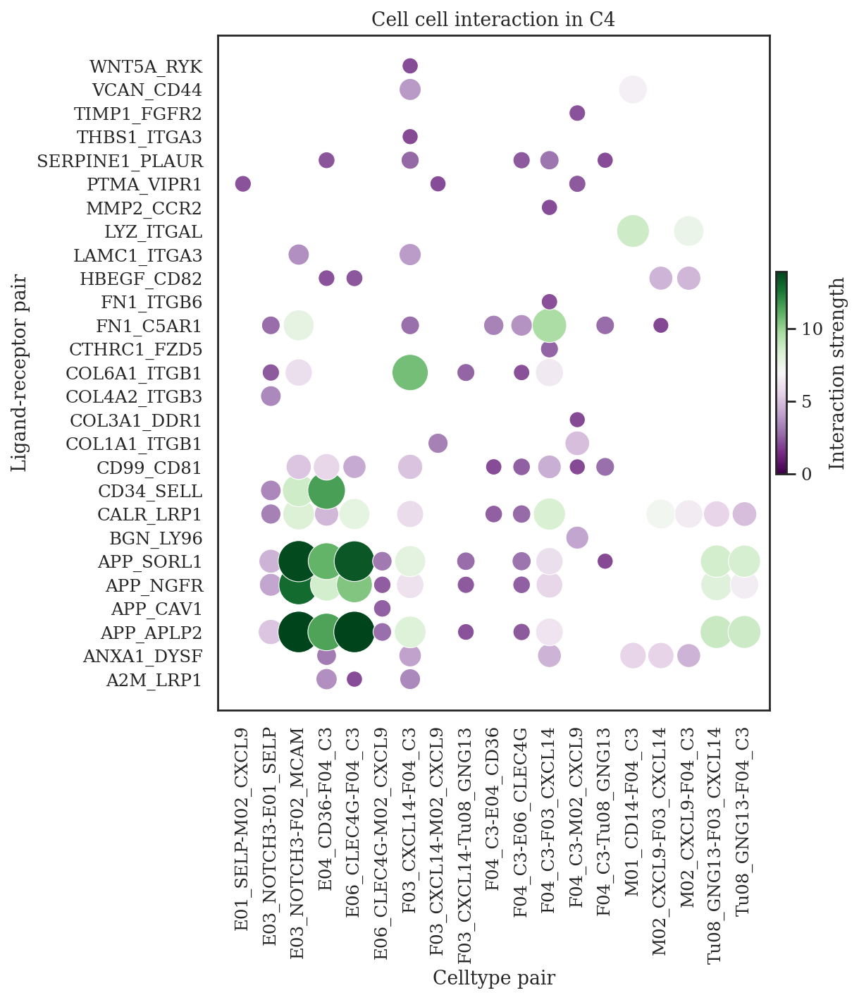

In [53]:
plt.figure(figsize=(8, 9))
group2_names = filtered_wide.columns
group1_names = filtered_wide.index

x, y = np.meshgrid(group1_names, group2_names)

x = x.flatten()
y = y.flatten()
exp_values = filtered_wide.T.values.flatten()
percent_values = filtered_wide.T.values.flatten()

scatter = plt.scatter(x, y, c=exp_values, s=percent_values*50, cmap='PRGn',
                       alpha=1, edgecolors="w", linewidth=0.5)

plt.colorbar(scatter, label='Interaction strength',pad=0.01,shrink=0.3)

# legend_sizes = [3,2,1.5,1,0]
# legend_sizes_scaled = [size * 50 for size in legend_sizes]
# legend_labels = ["P val < 1e-3",
#                  "P val < 1e-2",
#                  "P val < 5e-2",
#                  "P val < 1e-1",
#                  "P val > 1e-1",]

# for size, scaled_size, label in zip(legend_sizes, legend_sizes_scaled, legend_labels):
#     plt.scatter([], [], s=scaled_size, c='gray', alpha=0.7, edgecolors="w", label=label)

# plt.legend(title='P value', loc='center left', bbox_to_anchor=(1.01, 0.15), frameon=False)

plt.ylabel('Ligand-receptor pair')
plt.xlabel('Celltype pair')
plt.title('Cell cell interaction in C4')

plt.xticks(np.arange(len(group1_names)), group1_names, rotation=90)
plt.yticks(np.arange(len(group2_names)), group2_names)

plt.tight_layout()
# plt.savefig("Figure/8_4_CCI_L1.pdf",dpi=300)
plt.show()

## Inferred attention

In [48]:
niche_res = pd.read_csv("Results/SVLR/niche_res_topic15.csv",index_col=0)
mu = niche_res @ eta.values
mu.columns = [i + "_mu" for i in eta.columns]
# mu.index = adata.obs_names

In [49]:
mu_theta = pd.concat([mu,adata_tmp.to_df()],axis=1)

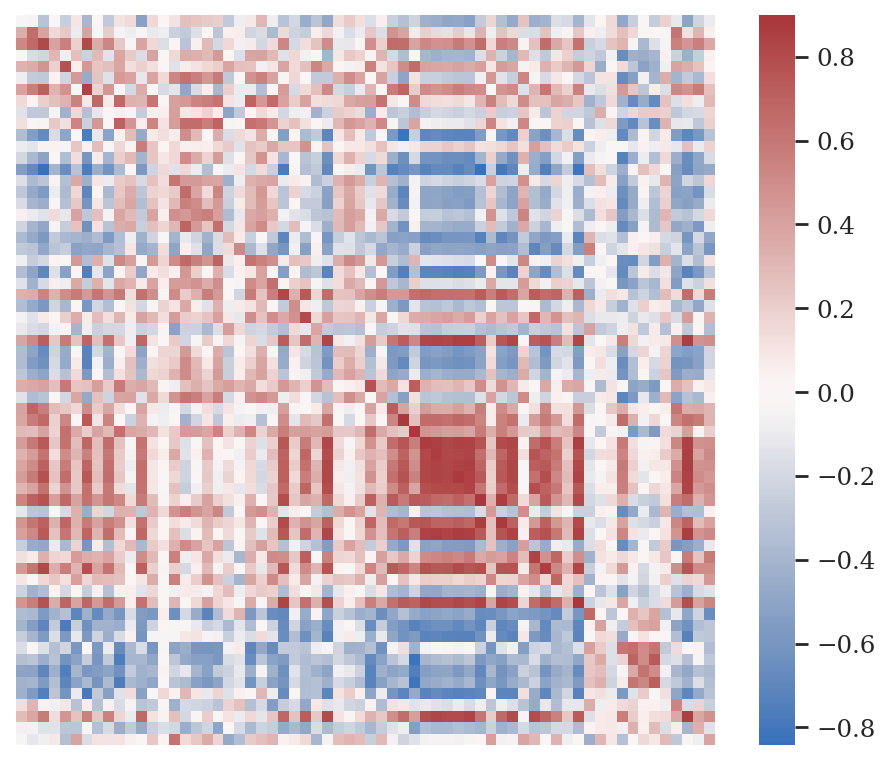

In [ ]:
plt.figure(figsize=(7,6))
sns.heatmap(mu_theta.corr('spearman').iloc[0:64,64:128],cmap='vlag',center=0,
            xticklabels = False,yticklabels = False)
plt.savefig("Figure/mu_prop_cor.pdf", dpi=300, bbox_inches='tight')
plt.show()

## Single cell analysis

In [98]:
from scipy import stats

In [95]:
nonimmune_meta = pd.read_csv("/home/liuchang/4.0_Resource/2.0_scRNA/1.0_Cancer/1.0_COAD/GSE225857/Data/GSM7058755_non_immune_meta.txt.gz",
                         compression = 'gzip',sep="\t",index_col=0)

In [96]:
endothelial = nonimmune_meta[nonimmune_meta['cluster'].str.startswith('E0')] 
count_df = endothelial.groupby(['orig.ident', 'organs', 'cluster']).size().reset_index(name='count')
total_count_df = endothelial.groupby(['orig.ident', 'organs']).size().reset_index(name='total_count')
merged_df = pd.merge(count_df, total_count_df, on=['orig.ident', 'organs'])
merged_df['percentage'] = merged_df['count'] / merged_df['total_count'] * 100
final_df = merged_df.pivot_table(index=['orig.ident', 'organs'], columns='cluster', values='percentage', aggfunc='first').reset_index()
final_df = final_df.fillna(0)

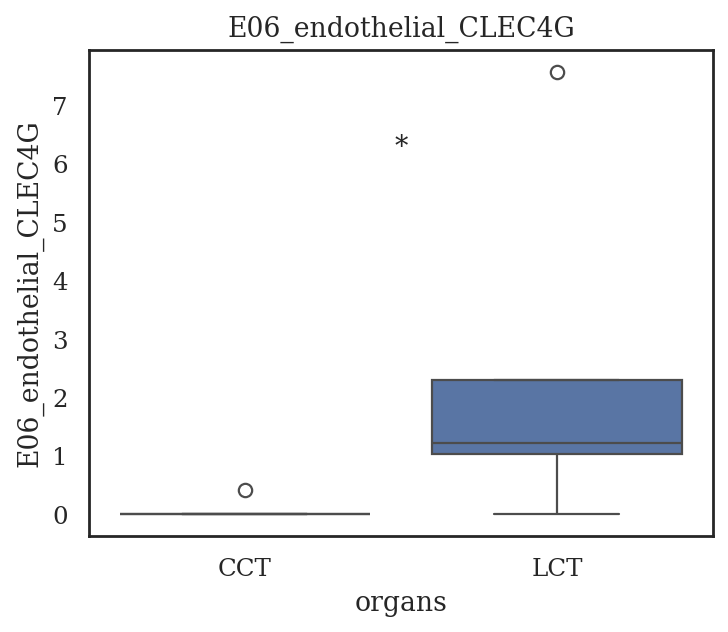

In [99]:
plt.figure(figsize=(5, 4))
ax = sns.boxplot(data=final_df, x='organs', y='E06_endothelial_CLEC4G')

groups = final_df['organs'].unique()
p_values = {}
for i, group1 in enumerate(groups):
    for group2 in groups[i+1:]:
        data1 = final_df[final_df['organs'] == group1]['E06_endothelial_CLEC4G']
        data2 = final_df[final_df['organs'] == group2]['E06_endothelial_CLEC4G']
        
        stat, p_value = stats.kruskal(data1, data2)
        p_values[(group1, group2)] = p_value

for (group1, group2), p_value in p_values.items():
    x1 = list(groups).index(group1)
    x2 = list(groups).index(group2)
    y_max = max(final_df['E06_endothelial_CLEC4G']) * 0.8 
    if p_value < 0.05:
        ax.text((x1 + x2) / 2, y_max, '*', ha='center', va='bottom', fontsize=12)

plt.title("E06_endothelial_CLEC4G")
plt.show()


In [104]:
immune_meta = pd.read_csv("/home/liuchang/4.0_Resource/2.0_scRNA/1.0_Cancer/1.0_COAD/GSE225857/Data/GSM7058754_immune_meta.txt.gz",
                         compression = 'gzip',sep="\t",index_col=0)

In [101]:
endothelial = immune_meta[immune_meta['cluster'].str.startswith('M')]
count_df = endothelial.groupby(['orig.ident', 'organs', 'cluster']).size().reset_index(name='count')
total_count_df = endothelial.groupby(['orig.ident', 'organs']).size().reset_index(name='total_count')
merged_df = pd.merge(count_df, total_count_df, on=['orig.ident', 'organs'])
merged_df['percentage'] = merged_df['count'] / merged_df['total_count'] * 100
final_df_mac = merged_df.pivot_table(index=['orig.ident', 'organs'], columns='cluster', values='percentage', aggfunc='first').reset_index()
final_df_mac = final_df_mac.fillna(0)

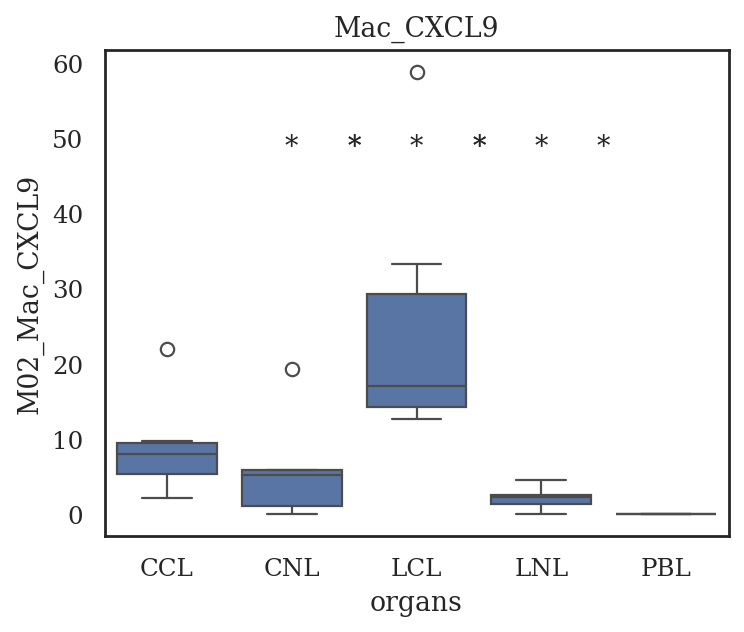

In [102]:
plt.figure(figsize=(5, 4))
ax = sns.boxplot(data=final_df_mac, x='organs', y='M02_Mac_CXCL9')

groups = final_df_mac['organs'].unique()
p_values = {}
for i, group1 in enumerate(groups):
    for group2 in groups[i+1:]:
        data1 = final_df_mac[final_df_mac['organs'] == group1]['M02_Mac_CXCL9']
        data2 = final_df_mac[final_df_mac['organs'] == group2]['M02_Mac_CXCL9']
        
        stat, p_value = stats.kruskal(data1, data2)
        p_values[(group1, group2)] = p_value

for (group1, group2), p_value in p_values.items():
    x1 = list(groups).index(group1)
    x2 = list(groups).index(group2)
    y_max = max(final_df_mac['M02_Mac_CXCL9']) * 0.8 
    if p_value < 0.05:
        ax.text((x1 + x2) / 2, y_max, '*', ha='center', va='bottom', fontsize=12)

plt.title("Mac_CXCL9")
plt.show()


In [106]:
endothelial = immune_meta[immune_meta['cluster'].str.startswith('T')]
count_df = endothelial.groupby(['orig.ident', 'organs', 'cluster']).size().reset_index(name='count')
total_count_df = endothelial.groupby(['orig.ident', 'organs']).size().reset_index(name='total_count')
merged_df = pd.merge(count_df, total_count_df, on=['orig.ident', 'organs'])
merged_df['percentage'] = merged_df['count'] / merged_df['total_count'] * 100
final_df_T = merged_df.pivot_table(index=['orig.ident', 'organs'], columns='cluster', values='percentage', aggfunc='first').reset_index()
final_df_T = final_df_T.fillna(0)

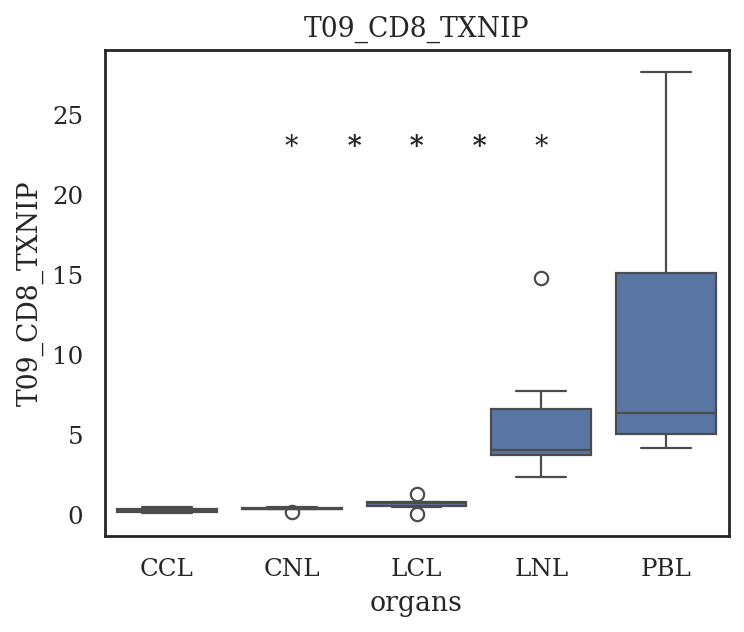

In [107]:
plt.figure(figsize=(5, 4))
ax = sns.boxplot(data=final_df_T, x='organs', y='T09_CD8_TXNIP')

groups = final_df_T['organs'].unique()
p_values = {}
for i, group1 in enumerate(groups):
    for group2 in groups[i+1:]:
        data1 = final_df_T[final_df_T['organs'] == group1]['T09_CD8_TXNIP']
        data2 = final_df_T[final_df_T['organs'] == group2]['T09_CD8_TXNIP']
        
        stat, p_value = stats.kruskal(data1, data2)
        p_values[(group1, group2)] = p_value

for (group1, group2), p_value in p_values.items():
    x1 = list(groups).index(group1)
    x2 = list(groups).index(group2)
    y_max = max(final_df_T['T09_CD8_TXNIP']) * 0.8 
    if p_value < 0.05:
        ax.text((x1 + x2) / 2, y_max, '*', ha='center', va='bottom', fontsize=12)

plt.title("T09_CD8_TXNIP")
plt.show()

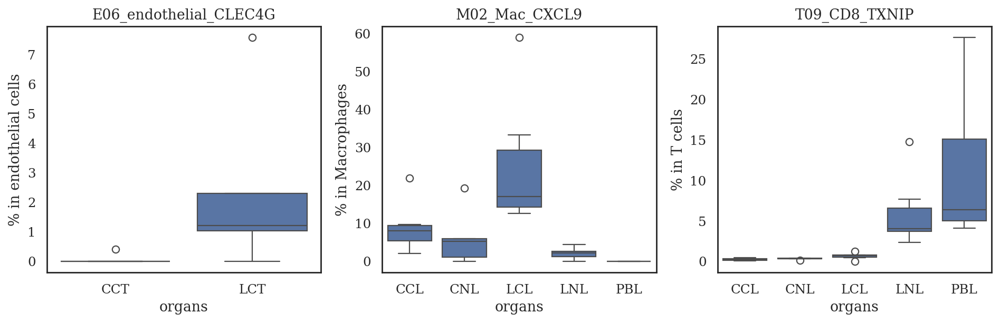

In [109]:
fig, axes = plt.subplots(1, 3, figsize=(12, 4))

sns.boxplot(data=final_df, x='organs', y='E06_endothelial_CLEC4G', ax=axes[0])
axes[0].set_title("E06_endothelial_CLEC4G")
axes[0].set_ylabel("% in endothelial cells") 

sns.boxplot(data=final_df_mac, x='organs', y='M02_Mac_CXCL9', ax=axes[1])
axes[1].set_title("M02_Mac_CXCL9")
axes[1].set_ylabel("% in Macrophages") 

sns.boxplot(data=final_df_T, x='organs', y='T09_CD8_TXNIP', ax=axes[2])
axes[2].set_title("T09_CD8_TXNIP")
axes[2].set_ylabel("% in T cells") 

plt.tight_layout()
plt.savefig('Figure/match_scRNA_proportion.pdf')
plt.show()